# IP_Router_Port_Total_Traffic_Rate

# Step 1: Import Libraries

In [2]:
# Import Libraries

import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import notebook
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
warnings.filterwarnings("ignore")
from prettytable import PrettyTable 
from astropy.table import Table, Column
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix

# Step 2: Load Dataset

In [2]:
# Load Dataset

sample_data = pd.read_csv("Total_Traffic_Rate_5min_7days_20nodes.csv")
sample_data

,Unnamed: 0,"13/12/21, 00:00","13/12/21, 00:05","13/12/21, 00:10","13/12/21, 00:15","13/12/21, 00:20","13/12/21, 00:25","13/12/21, 00:30","13/12/21, 00:35","13/12/21, 00:40",...,"19/12/21, 23:10","19/12/21, 23:15","19/12/21, 23:20","19/12/21, 23:25","19/12/21, 23:30","19/12/21, 23:35","19/12/21, 23:40","19/12/21, 23:45","19/12/21, 23:50","19/12/21, 23:55"
0,NR_RTR_PORT_1,14.59,11.25,3.87,6.52,5.95,7.30,9.43,8.73,8.27,...,9.58,9.57,10.18,10.57,8.63,11.01,10.85,10.87,10.78,10.38
1,NR_RTR_PORT_2,2.92,2.25,3.17,4.29,3.90,4.87,5.72,4.80,4.31,...,14.12,13.65,14.13,14.45,11.22,14.43,13.78,13.49,13.22,12.33
2,NR_RTR_PORT_3,46.92,39.36,30.80,23.80,19.15,18.39,24.35,26.47,25.71,...,39.40,41.99,46.05,49.94,41.94,55.61,58.16,58.03,60.48,61.27
3,NR_RTR_PORT_4,77.04,65.09,50.64,39.23,31.77,31.48,42.28,46.57,44.61,...,68.97,72.63,79.94,86.95,72.81,95.68,99.96,100.46,104.46,104.81
4,NR_RTR_PORT_5,82.44,73.56,60.28,48.32,38.86,33.27,39.36,44.78,42.81,...,63.47,67.96,73.23,82.73,80.63,84.96,103.38,101.02,105.52,109.70
5,NR_RTR_PORT_6,74.90,66.27,54.27,44.19,35.67,30.39,36.56,40.88,39.19,...,59.21,63.57,68.70,77.51,75.46,79.65,96.51,94.34,98.87,102.55
6,NR_RTR_PORT_7,50.99,44.02,35.24,28.01,22.70,20.22,25.79,30.41,31.22,...,40.89,42.87,45.05,50.16,48.16,48.64,60.80,58.74,62.15,63.03
7,NR_RTR_PORT_8,117.58,104.36,84.55,67.40,53.61,46.50,56.46,64.84,63.56,...,92.56,97.92,105.98,120.62,116.80,122.68,152.34,147.73,152.93,157.00
8,NR_RTR_PORT_9,61.54,54.12,44.65,35.45,28.57,24.41,29.01,32.78,31.68,...,41.59,44.69,48.33,55.10,53.16,56.38,68.52,67.14,69.91,71.88
9,NR_RTR_PORT_10,58.69,51.25,42.19,33.55,27.00,23.58,28.64,32.02,31.22,...,49.34,52.43,56.57,63.79,62.10,65.38,79.95,77.59,81.13,82.95


# Step 3: Pre-Process Dataset

In [3]:
sample_data = sample_data.T[1:]

In [4]:
sample_data = sample_data.reset_index()

In [5]:
sample_data = sample_data.rename({'index': 'date'}, axis=1)
sample_data['date'] = pd.to_datetime(sample_data['date'], errors='coerce')

In [6]:
sample_data

,date,0,1,2,3,4,5,6,7,8,...,10,11,12,13,14,15,16,17,18,19
0,2021-12-13 00:00:00,14.59,2.92,46.92,77.04,82.44,74.9,50.99,117.58,61.54,...,143.11,50.11,37.33,50.27,54.46,75.14,77.89,71.68,42.88,66.54
1,2021-12-13 00:05:00,11.25,2.25,39.36,65.09,73.56,66.27,44.02,104.36,54.12,...,125.45,43.13,32.18,43.25,45.21,64.82,66.07,63.51,37.34,59.12
2,2021-12-13 00:10:00,3.87,3.17,30.8,50.64,60.28,54.27,35.24,84.55,44.65,...,101.69,34.31,25.63,34.37,35.18,51.26,51.36,51.61,28.67,49.65
3,2021-12-13 00:15:00,6.52,4.29,23.8,39.23,48.32,44.19,28.01,67.4,35.45,...,79.44,26.12,19.59,26.5,26.93,39.5,38.26,41.02,21.33,40.45
4,2021-12-13 00:20:00,5.95,3.9,19.15,31.77,38.86,35.67,22.7,53.61,28.57,...,62.97,20.87,15.3,21.05,22.15,31.37,30.44,33.62,16.84,33.57
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2011,2021-12-19 23:35:00,11.01,14.43,55.61,95.68,84.96,79.65,48.64,122.68,56.38,...,140.77,55.76,42.03,55.63,82.08,91.82,86.79,85.74,48.76,49.66
2012,2021-12-19 23:40:00,10.85,13.78,58.16,99.96,103.38,96.51,60.8,152.34,68.52,...,168.72,58.78,44.22,58.33,85.48,104,91.04,106.81,51.06,48.58
2013,2021-12-19 23:45:00,10.87,13.49,58.03,100.46,101.02,94.34,58.74,147.73,67.14,...,163.76,59.04,43.92,58.74,86.16,103.87,91.12,102.97,51.41,46.7
2014,2021-12-19 23:50:00,10.78,13.22,60.48,104.46,105.52,98.87,62.15,152.93,69.91,...,170.1,61.23,46.32,61.34,88.37,107.77,95.14,108.39,53.46,43.48


## Fill Null Values

In [7]:
for i in range(len(sample_data.columns)-1):
    sample_data[i] = sample_data[i].groupby(sample_data.date.dt.hour).transform(lambda x: x.fillna(x.median()))

# Step 4: Data Visulization

In [8]:
df_day = pd.DataFrame()
for i in range(len(sample_data.columns)-1):
    df_day[i] = sample_data.groupby(sample_data.date)[i].sum()

In [9]:
df_day.index = pd.DatetimeIndex(df_day.index.values, freq=df_day.index.inferred_freq)

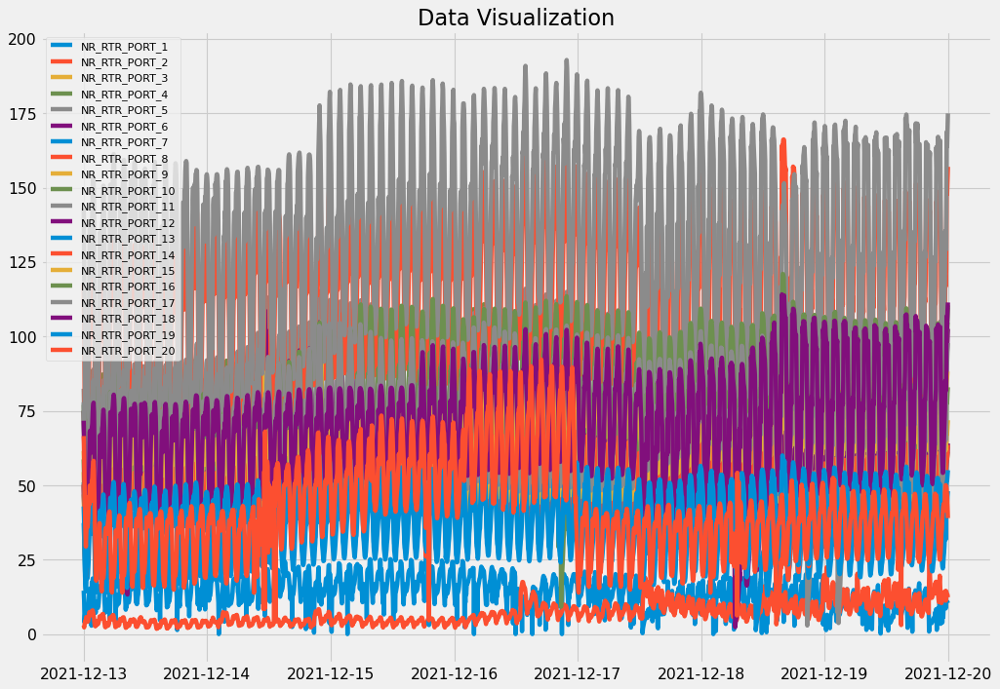

In [10]:
from matplotlib.pyplot import figure
figure(figsize=(14, 10), dpi=80)

params = {'legend.fontsize': 10,'legend.handlelength': 2}
plt.rcParams.update(params)
plt.plot(df_day[0], label="NR_RTR_PORT_1")
plt.plot(df_day[1], label="NR_RTR_PORT_2")
plt.plot(df_day[2], label="NR_RTR_PORT_3")
plt.plot(df_day[3], label="NR_RTR_PORT_4")
plt.plot(df_day[4], label="NR_RTR_PORT_5")
plt.plot(df_day[5], label="NR_RTR_PORT_6")
plt.plot(df_day[6], label="NR_RTR_PORT_7")
plt.plot(df_day[7], label="NR_RTR_PORT_8")
plt.plot(df_day[8], label="NR_RTR_PORT_9")
plt.plot(df_day[9], label="NR_RTR_PORT_10")
plt.plot(df_day[10], label="NR_RTR_PORT_11")
plt.plot(df_day[11], label="NR_RTR_PORT_12")
plt.plot(df_day[12], label="NR_RTR_PORT_13")
plt.plot(df_day[13], label="NR_RTR_PORT_14")
plt.plot(df_day[14], label="NR_RTR_PORT_15")
plt.plot(df_day[15], label="NR_RTR_PORT_16")
plt.plot(df_day[16], label="NR_RTR_PORT_17")
plt.plot(df_day[17], label="NR_RTR_PORT_18")
plt.plot(df_day[18], label="NR_RTR_PORT_19")
plt.plot(df_day[19], label="NR_RTR_PORT_20")

plt.title("Data Visualization")
plt.legend(loc="upper left")
plt.show()

## Step 4.1: Visualize all Instances with plotly

In [11]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=df_day.index, y=df_day[i], name = "NR_RTR_PORT_" + str(i+1)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with plotly")
fig.show()

## Step 4.2: Visualize all Instances with boxplot

In [12]:
import plotly.graph_objects as px
import numpy as np
 
plot = px.Figure()

for i in range(len(df_day.columns)):
    plot.add_trace(px.Box(y=df_day[i], name = "IP_Link_" + str(i+1)))

plot.update_layout(height=5000)
plot.show()

# Step 5: Outlier Detection

## Step 5.1: Isolation Forest Outlier Detection

In [13]:
import plotly.express as px

In [14]:
X = df_day.T

In [15]:
# Import Libraries
from sklearn.ensemble import IsolationForest

# Identify outliers in the training dataset
Isolation_Forest = IsolationForest()

outlier1 = pd.DataFrame()
list_1 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = Isolation_Forest.fit_predict(a)
    c = pd.DataFrame(b)
    print("\n\nOutliers Detected in NR_RTR_PORT_"+str(i+1)+":", c[c == -1].count().sum())
    print("========================================\n")
    outlier1 = outlier1.append(c.T)
    list_1.append(c[c == -1].count().sum())

print("\nTotal Outliers Detected: ", outlier1[outlier1 == -1].count().sum())
print("=================================\n")

x = ["NR_RTR_PORT_1",
    "NR_RTR_PORT_2",
    "NR_RTR_PORT_3",
    "NR_RTR_PORT_4",
    "NR_RTR_PORT_5",
    "NR_RTR_PORT_6",
    "NR_RTR_PORT_7",
    "NR_RTR_PORT_8",
    "NR_RTR_PORT_9",
    "NR_RTR_PORT_10",
    "NR_RTR_PORT_11",
    "NR_RTR_PORT_12",
    "NR_RTR_PORT_13",
    "NR_RTR_PORT_14",
    "NR_RTR_PORT_15",
    "NR_RTR_PORT_16",
    "NR_RTR_PORT_17",
    "NR_RTR_PORT_18",
    "NR_RTR_PORT_19",
    "NR_RTR_PORT_20"
]
y = list_1

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by Isolation Forest:")
print("======================================\n")
outlier1 = outlier1.reset_index(drop=True)
outlier1

  0%|          | 0/20 [00:00<?, ?it/s]



Outliers Detected in NR_RTR_PORT_1: 435



Outliers Detected in NR_RTR_PORT_2: 500



Outliers Detected in NR_RTR_PORT_3: 653



Outliers Detected in NR_RTR_PORT_4: 671



Outliers Detected in NR_RTR_PORT_5: 460



Outliers Detected in NR_RTR_PORT_6: 572



Outliers Detected in NR_RTR_PORT_7: 556



Outliers Detected in NR_RTR_PORT_8: 677



Outliers Detected in NR_RTR_PORT_9: 390



Outliers Detected in NR_RTR_PORT_10: 441



Outliers Detected in NR_RTR_PORT_11: 729



Outliers Detected in NR_RTR_PORT_12: 548



Outliers Detected in NR_RTR_PORT_13: 418



Outliers Detected in NR_RTR_PORT_14: 703



Outliers Detected in NR_RTR_PORT_15: 639



Outliers Detected in NR_RTR_PORT_16: 527



Outliers Detected in NR_RTR_PORT_17: 659



Outliers Detected in NR_RTR_PORT_18: 693



Outliers Detected in NR_RTR_PORT_19: 515



Outliers Detected in NR_RTR_PORT_20: 683


Total Outliers Detected:  11469





Outliers Detected by Isolation Forest:



,0,1,2,3,4,5,6,7,8,9,...,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,1,1,-1,-1,-1,-1,1,-1,1,-1,...,1,1,1,1,-1,1,1,1,1,1
1,-1,-1,1,1,1,1,1,1,1,1,...,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
2,1,1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,1,-1,-1,-1
3,-1,1,-1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,-1,1,-1,-1
4,1,1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,1,1,-1,-1
5,1,1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,1,1,-1,-1
6,1,1,-1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,1,1,1,-1
7,1,-1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,-1,1,1,1,-1,1,-1,-1
8,1,1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,1,1,1,-1
9,1,1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,1,1,-1,-1,-1,-1


In [16]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="NR_RTR_PORT_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier1.loc[i][outlier1.loc[i]==-1].index].index, y=X.loc[i][outlier1.loc[i][outlier1.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

## Step 5.2: AutoEncoders Outlier Detection 

In [17]:
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras import Model, Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError

In [18]:
class AutoEncoder(Model):
  def __init__(self, output_units, code_size=8):
    super().__init__()
    self.encoder = Sequential([
      Dense(64, activation='relu'),
      Dropout(0.1),
      Dense(32, activation='relu'),
      Dropout(0.1),
      Dense(16, activation='relu'),
      Dropout(0.1),
      Dense(code_size, activation='relu')
    ])
    self.decoder = Sequential([
      Dense(16, activation='relu'),
      Dropout(0.1),
      Dense(32, activation='relu'),
      Dropout(0.1),
      Dense(64, activation='relu'),
      Dropout(0.1),
      Dense(output_units, activation='sigmoid')
    ])
  
  def call(self, inputs):
    encoded = self.encoder(inputs)
    decoded = self.decoder(encoded)
    return decoded
  
model = AutoEncoder(output_units = 1)

In [19]:
def find_threshold(model, x_train_scaled):
    reconstructions = model.predict(x_train_scaled)
    reconstruction_errors = tf.keras.losses.msle(reconstructions, x_train_scaled)
    threshold = np.mean(reconstruction_errors.numpy()) + np.std(reconstruction_errors.numpy())
    return threshold

In [20]:
def get_predictions(model, x_test_scaled, threshold):
    predictions = model.predict(x_test_scaled)
    errors = tf.keras.losses.msle(predictions, x_test_scaled)
    anomaly_mask = pd.Series(errors) > threshold
    preds = anomaly_mask.map(lambda x: 0.0 if x == True else 1.0)
    return preds

In [21]:
outlier2 = pd.DataFrame()
list_2 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    threshold = find_threshold(model, a)
    predictions = get_predictions(model, a, threshold)
    c = pd.DataFrame(predictions)
    c = c.replace({0: -1}).astype("int")
    print("\n\nOutliers Detected in NR_RTR_PORT_"+str(i+1)+":", c[c == -1].count().sum())
    print("========================================\n")
    outlier2 = outlier2.append(c.T)
    list_2.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier2[outlier2 == -1].count().sum())
print("=================================\n")

x = ["NR_RTR_PORT_1",
    "NR_RTR_PORT_2",
    "NR_RTR_PORT_3",
    "NR_RTR_PORT_4",
    "NR_RTR_PORT_5",
    "NR_RTR_PORT_6",
    "NR_RTR_PORT_7",
    "NR_RTR_PORT_8",
    "NR_RTR_PORT_9",
    "NR_RTR_PORT_10",
    "NR_RTR_PORT_11",
    "NR_RTR_PORT_12",
    "NR_RTR_PORT_13",
    "NR_RTR_PORT_14",
    "NR_RTR_PORT_15",
    "NR_RTR_PORT_16",
    "NR_RTR_PORT_17",
    "NR_RTR_PORT_18",
    "NR_RTR_PORT_19",
    "NR_RTR_PORT_20"
]
y = list_2

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by Isolation Forest:")
print("======================================\n")
outlier2 = outlier2.reset_index(drop=True)
outlier2

  0%|          | 0/20 [00:00<?, ?it/s]



Outliers Detected in NR_RTR_PORT_1: 344



Outliers Detected in NR_RTR_PORT_2: 347



Outliers Detected in NR_RTR_PORT_3: 368



Outliers Detected in NR_RTR_PORT_4: 351



Outliers Detected in NR_RTR_PORT_5: 290



Outliers Detected in NR_RTR_PORT_6: 395



Outliers Detected in NR_RTR_PORT_7: 313



Outliers Detected in NR_RTR_PORT_8: 400



Outliers Detected in NR_RTR_PORT_9: 295



Outliers Detected in NR_RTR_PORT_10: 377



Outliers Detected in NR_RTR_PORT_11: 345



Outliers Detected in NR_RTR_PORT_12: 315



Outliers Detected in NR_RTR_PORT_13: 305



Outliers Detected in NR_RTR_PORT_14: 303



Outliers Detected in NR_RTR_PORT_15: 382



Outliers Detected in NR_RTR_PORT_16: 401



Outliers Detected in NR_RTR_PORT_17: 357



Outliers Detected in NR_RTR_PORT_18: 344



Outliers Detected in NR_RTR_PORT_19: 356



Outliers Detected in NR_RTR_PORT_20: 324



Number Outliers Detected:  6912





Outliers Detected by Isolation Forest:



,0,1,2,3,4,5,6,7,8,9,...,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
2,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,-1,-1,-1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,-1,-1,-1,-1,-1
4,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,-1,-1,-1
5,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,-1,-1,-1
6,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,1,-1,-1
7,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,-1,-1,-1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,1,-1,-1
9,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,-1,-1,-1,-1


In [22]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="NR_RTR_PORT_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier2.loc[i][outlier2.loc[i]==-1].index].index, y=X.loc[i][outlier2.loc[i][outlier2.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

## Step 5.3: Local Outlier Factor Outlier Detection 

In [23]:
# Import Libraries
from sklearn.neighbors import LocalOutlierFactor

# Identify outliers in the training dataset
Local_Outlier_Factor = LocalOutlierFactor()

outlier3 = pd.DataFrame()
list_3 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = Local_Outlier_Factor.fit_predict(a)
    c = pd.DataFrame(b)
    print("\n\nOutliers Detected in NR_RTR_PORT_"+str(i+1)+":", c[c == -1].count().sum())
    print("========================================\n")
    outlier3 = outlier3.append(c.T)
    list_3.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier3[outlier3 == -1].count().sum())
print("=================================\n")

x = ["NR_RTR_PORT_1",
    "NR_RTR_PORT_2",
    "NR_RTR_PORT_3",
    "NR_RTR_PORT_4",
    "NR_RTR_PORT_5",
    "NR_RTR_PORT_6",
    "NR_RTR_PORT_7",
    "NR_RTR_PORT_8",
    "NR_RTR_PORT_9",
    "NR_RTR_PORT_10",
    "NR_RTR_PORT_11",
    "NR_RTR_PORT_12",
    "NR_RTR_PORT_13",
    "NR_RTR_PORT_14",
    "NR_RTR_PORT_15",
    "NR_RTR_PORT_16",
    "NR_RTR_PORT_17",
    "NR_RTR_PORT_18",
    "NR_RTR_PORT_19",
    "NR_RTR_PORT_20"
]
y = list_3

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by LocalOutlierFactor:")
print("========================================\n")
outlier3 = outlier3.reset_index(drop=True)
outlier3

  0%|          | 0/20 [00:00<?, ?it/s]



Outliers Detected in NR_RTR_PORT_1: 0



Outliers Detected in NR_RTR_PORT_2: 10



Outliers Detected in NR_RTR_PORT_3: 31



Outliers Detected in NR_RTR_PORT_4: 19



Outliers Detected in NR_RTR_PORT_5: 16



Outliers Detected in NR_RTR_PORT_6: 26



Outliers Detected in NR_RTR_PORT_7: 13



Outliers Detected in NR_RTR_PORT_8: 12



Outliers Detected in NR_RTR_PORT_9: 12



Outliers Detected in NR_RTR_PORT_10: 20



Outliers Detected in NR_RTR_PORT_11: 18



Outliers Detected in NR_RTR_PORT_12: 20



Outliers Detected in NR_RTR_PORT_13: 22



Outliers Detected in NR_RTR_PORT_14: 15



Outliers Detected in NR_RTR_PORT_15: 12



Outliers Detected in NR_RTR_PORT_16: 11



Outliers Detected in NR_RTR_PORT_17: 12



Outliers Detected in NR_RTR_PORT_18: 14



Outliers Detected in NR_RTR_PORT_19: 14



Outliers Detected in NR_RTR_PORT_20: 6



Number Outliers Detected:  303





Outliers Detected by LocalOutlierFactor:



,0,1,2,3,4,5,6,7,8,9,...,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,-1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
5,1,1,1,1,1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
6,1,1,1,1,-1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8,1,1,1,1,1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,1,1,-1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [24]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="NR_RTR_PORT_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier3.loc[i][outlier3.loc[i]==-1].index].index, y=X.loc[i][outlier3.loc[i][outlier3.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

## Step 5.4:  One Class SVM Outlier Detection

In [25]:
# Import Libraries
from sklearn.svm import OneClassSVM

# Identify outliers in the training dataset
One_Class_SVM = OneClassSVM()

outlier4 = pd.DataFrame()
list_4 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = One_Class_SVM.fit_predict(a)
    c = pd.DataFrame(b)
    print("\n\nOutliers Detected in NR_RTR_PORT_"+str(i+1)+":", c[c == -1].count().sum())
    print("========================================\n")
    outlier4 = outlier4.append(c.T)
    list_4.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier4[outlier4 == -1].count().sum())
print("=================================\n")

x = ["NR_RTR_PORT_1",
    "NR_RTR_PORT_2",
    "NR_RTR_PORT_3",
    "NR_RTR_PORT_4",
    "NR_RTR_PORT_5",
    "NR_RTR_PORT_6",
    "NR_RTR_PORT_7",
    "NR_RTR_PORT_8",
    "NR_RTR_PORT_9",
    "NR_RTR_PORT_10",
    "NR_RTR_PORT_11",
    "NR_RTR_PORT_12",
    "NR_RTR_PORT_13",
    "NR_RTR_PORT_14",
    "NR_RTR_PORT_15",
    "NR_RTR_PORT_16",
    "NR_RTR_PORT_17",
    "NR_RTR_PORT_18",
    "NR_RTR_PORT_19",
    "NR_RTR_PORT_20"
]
y = list_4

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by OneClassSVM:")
print("=================================\n")
outlier4 = outlier4.reset_index(drop=True)
outlier4

  0%|          | 0/20 [00:00<?, ?it/s]



Outliers Detected in NR_RTR_PORT_1: 1009



Outliers Detected in NR_RTR_PORT_2: 1008



Outliers Detected in NR_RTR_PORT_3: 1005



Outliers Detected in NR_RTR_PORT_4: 1008



Outliers Detected in NR_RTR_PORT_5: 1010



Outliers Detected in NR_RTR_PORT_6: 1007



Outliers Detected in NR_RTR_PORT_7: 1007



Outliers Detected in NR_RTR_PORT_8: 1007



Outliers Detected in NR_RTR_PORT_9: 1006



Outliers Detected in NR_RTR_PORT_10: 1007



Outliers Detected in NR_RTR_PORT_11: 1004



Outliers Detected in NR_RTR_PORT_12: 1006



Outliers Detected in NR_RTR_PORT_13: 1006



Outliers Detected in NR_RTR_PORT_14: 1014



Outliers Detected in NR_RTR_PORT_15: 1007



Outliers Detected in NR_RTR_PORT_16: 1009



Outliers Detected in NR_RTR_PORT_17: 1009



Outliers Detected in NR_RTR_PORT_18: 1005



Outliers Detected in NR_RTR_PORT_19: 1005



Outliers Detected in NR_RTR_PORT_20: 1010



Number Outliers Detected:  20149





Outliers Detected by OneClassSVM:



,0,1,2,3,4,5,6,7,8,9,...,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,-1,1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,1,1,-1,1,1,1,1,1
1,-1,-1,-1,1,1,1,1,1,1,1,...,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
2,-1,1,-1,-1,-1,-1,-1,-1,-1,-1,...,1,-1,-1,1,-1,1,-1,-1,-1,-1
3,-1,1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,-1
4,1,1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,-1,1,-1,-1,-1,-1
5,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,-1,1,-1,-1,-1,-1
6,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,1,1,-1,-1,1,1,-1,1,-1,-1
7,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,1,-1,1,-1,-1,-1,-1
8,1,-1,1,-1,-1,-1,-1,-1,-1,-1,...,1,1,1,-1,-1,-1,-1,1,-1,-1
9,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,1,-1,1,1,1,1,-1,-1,-1,-1


In [26]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="NR_RTR_PORT_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier4.loc[i][outlier4.loc[i]==-1].index].index, y=X.loc[i][outlier4.loc[i][outlier4.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

# Step 5.5: DBSCAN Outlier Detection 

In [27]:
# Import Libraries
from sklearn.cluster import DBSCAN

# Identify outliers in the training dataset
outlier_detection = DBSCAN()

outlier5 = pd.DataFrame()
list_5 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = outlier_detection.fit_predict(a)
    c = pd.DataFrame(b)
    c = c.replace({0: 1}).astype("int")
    print("\n\nOutliers Detected in NR_RTR_PORT_"+str(i+1)+":", c[c == -1].count().sum())
    print("========================================\n")
    outlier5 = outlier5.append(c.T)
    list_5.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier5[outlier5 == -1].count().sum())
print("=================================\n")

x = ["NR_RTR_PORT_1",
    "NR_RTR_PORT_2",
    "NR_RTR_PORT_3",
    "NR_RTR_PORT_4",
    "NR_RTR_PORT_5",
    "NR_RTR_PORT_6",
    "NR_RTR_PORT_7",
    "NR_RTR_PORT_8",
    "NR_RTR_PORT_9",
    "NR_RTR_PORT_10",
    "NR_RTR_PORT_11",
    "NR_RTR_PORT_12",
    "NR_RTR_PORT_13",
    "NR_RTR_PORT_14",
    "NR_RTR_PORT_15",
    "NR_RTR_PORT_16",
    "NR_RTR_PORT_17",
    "NR_RTR_PORT_18",
    "NR_RTR_PORT_19",
    "NR_RTR_PORT_20"
]
y = list_5

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by DBSCAN:")
print("============================\n")
outlier5 = outlier5.reset_index(drop=True)
for i in range(len(X)):
    outlier5.loc[i] = np.where(outlier5.loc[i] != -1, 1, outlier5.loc[i])
outlier5

  0%|          | 0/20 [00:00<?, ?it/s]



Outliers Detected in NR_RTR_PORT_1: 0



Outliers Detected in NR_RTR_PORT_2: 6



Outliers Detected in NR_RTR_PORT_3: 8



Outliers Detected in NR_RTR_PORT_4: 20



Outliers Detected in NR_RTR_PORT_5: 39



Outliers Detected in NR_RTR_PORT_6: 23



Outliers Detected in NR_RTR_PORT_7: 12



Outliers Detected in NR_RTR_PORT_8: 24



Outliers Detected in NR_RTR_PORT_9: 11



Outliers Detected in NR_RTR_PORT_10: 22



Outliers Detected in NR_RTR_PORT_11: 27



Outliers Detected in NR_RTR_PORT_12: 18



Outliers Detected in NR_RTR_PORT_13: 19



Outliers Detected in NR_RTR_PORT_14: 15



Outliers Detected in NR_RTR_PORT_15: 18



Outliers Detected in NR_RTR_PORT_16: 17



Outliers Detected in NR_RTR_PORT_17: 13



Outliers Detected in NR_RTR_PORT_18: 22



Outliers Detected in NR_RTR_PORT_19: 10



Outliers Detected in NR_RTR_PORT_20: 16



Number Outliers Detected:  340





Outliers Detected by DBSCAN:



,0,1,2,3,4,5,6,7,8,9,...,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,-1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
5,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
6,1,1,1,1,-1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,-1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,1,1,1,-1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [28]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="NR_RTR_PORT_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier5.loc[i][outlier5.loc[i]==-1].index].index, y=X.loc[i][outlier5.loc[i][outlier5.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

# Step 6: Evaluate the Performance

## Step 6.1: Prepare Testing Data

In [29]:
import statistics

X_test = X.copy()
for i in notebook.tqdm(range(len(X_test))):
    condition = np.average(X_test.loc[i]) + 3 * (statistics.stdev(X_test.loc[i]))
    X_test.loc[i] = np.where(X_test.loc[i] > condition, -1, X_test.loc[i])

for i in notebook.tqdm(range(len(X_test))):
    X_test.loc[i] = np.where(X_test.loc[i] != -1, 1, X_test.loc[i])
    
X_test = X_test.astype("int")
X_test

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

,2021-12-13 00:00:00,2021-12-13 00:05:00,2021-12-13 00:10:00,2021-12-13 00:15:00,2021-12-13 00:20:00,2021-12-13 00:25:00,2021-12-13 00:30:00,2021-12-13 00:35:00,2021-12-13 00:40:00,2021-12-13 00:45:00,...,2021-12-19 23:10:00,2021-12-19 23:15:00,2021-12-19 23:20:00,2021-12-19 23:25:00,2021-12-19 23:30:00,2021-12-19 23:35:00,2021-12-19 23:40:00,2021-12-19 23:45:00,2021-12-19 23:50:00,2021-12-19 23:55:00
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
5,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
6,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


## Step 6.2: Isolation Forest Outlier Detection



========================= NR_RTR_PORT_1 ======================




Accuracy Score:


  Accuracy:  78.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.78      0.88      2016

    accuracy                           0.78      2016
   macro avg       0.50      0.39      0.44      2016
weighted avg       1.00      0.78      0.88      2016



Confusion Matrix:


[[   0    0]
 [ 435 1581]]


Confusion Matrix with Heat MAP:




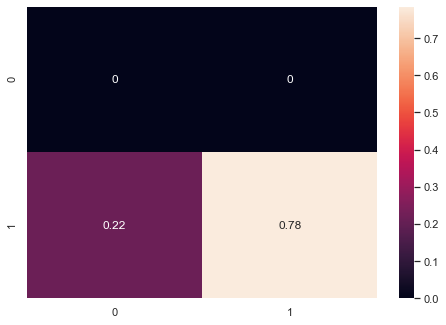



========================= NR_RTR_PORT_2 ======================




Accuracy Score:


  Accuracy:  75.99 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.06        16
           1       1.00      0.76      0.86      2000

    accuracy                           0.76      2016
   macro avg       0.52      0.88      0.46      2016
weighted avg       0.99      0.76      0.86      2016



Confusion Matrix:


[[  16    0]
 [ 484 1516]]


Confusion Matrix with Heat MAP:




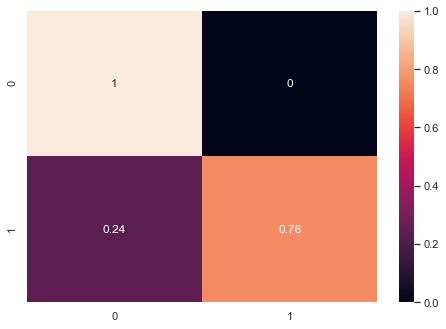



========================= NR_RTR_PORT_3 ======================




Accuracy Score:


  Accuracy:  67.61 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.68      0.81      2016

    accuracy                           0.68      2016
   macro avg       0.50      0.34      0.40      2016
weighted avg       1.00      0.68      0.81      2016



Confusion Matrix:


[[   0    0]
 [ 653 1363]]


Confusion Matrix with Heat MAP:




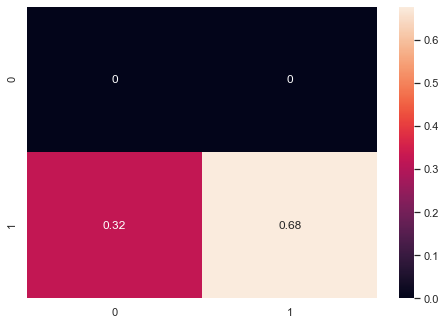



========================= NR_RTR_PORT_4 ======================




Accuracy Score:


  Accuracy:  66.72 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.67      0.80      2016

    accuracy                           0.67      2016
   macro avg       0.50      0.33      0.40      2016
weighted avg       1.00      0.67      0.80      2016



Confusion Matrix:


[[   0    0]
 [ 671 1345]]


Confusion Matrix with Heat MAP:




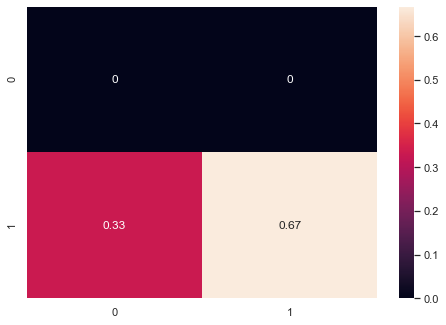



========================= NR_RTR_PORT_5 ======================




Accuracy Score:


  Accuracy:  77.18 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.77      0.87      2016

    accuracy                           0.77      2016
   macro avg       0.50      0.39      0.44      2016
weighted avg       1.00      0.77      0.87      2016



Confusion Matrix:


[[   0    0]
 [ 460 1556]]


Confusion Matrix with Heat MAP:




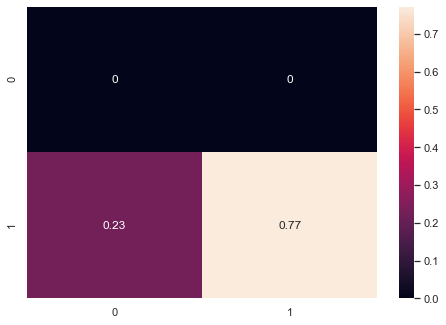



========================= NR_RTR_PORT_6 ======================




Accuracy Score:


  Accuracy:  71.63 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.72      0.83      2016

    accuracy                           0.72      2016
   macro avg       0.50      0.36      0.42      2016
weighted avg       1.00      0.72      0.83      2016



Confusion Matrix:


[[   0    0]
 [ 572 1444]]


Confusion Matrix with Heat MAP:




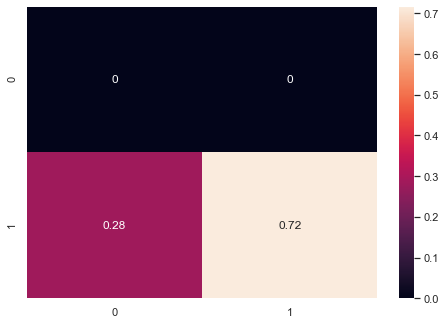



========================= NR_RTR_PORT_7 ======================




Accuracy Score:


  Accuracy:  72.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.72      0.84      2016

    accuracy                           0.72      2016
   macro avg       0.50      0.36      0.42      2016
weighted avg       1.00      0.72      0.84      2016



Confusion Matrix:


[[   0    0]
 [ 556 1460]]


Confusion Matrix with Heat MAP:




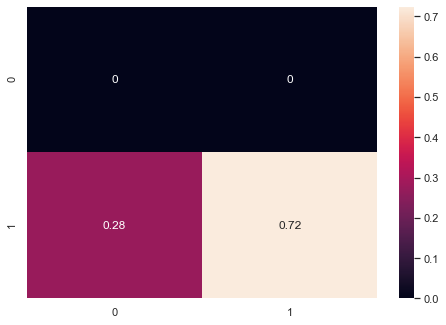



========================= NR_RTR_PORT_8 ======================




Accuracy Score:


  Accuracy:  66.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.66      0.80      2016

    accuracy                           0.66      2016
   macro avg       0.50      0.33      0.40      2016
weighted avg       1.00      0.66      0.80      2016



Confusion Matrix:


[[   0    0]
 [ 677 1339]]


Confusion Matrix with Heat MAP:




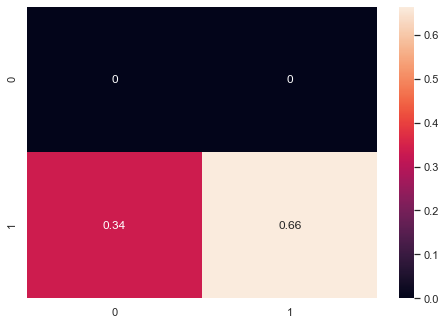



========================= NR_RTR_PORT_9 ======================




Accuracy Score:


  Accuracy:  80.7 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         1
           1       1.00      0.81      0.89      2015

    accuracy                           0.81      2016
   macro avg       0.50      0.90      0.45      2016
weighted avg       1.00      0.81      0.89      2016



Confusion Matrix:


[[   1    0]
 [ 389 1626]]


Confusion Matrix with Heat MAP:




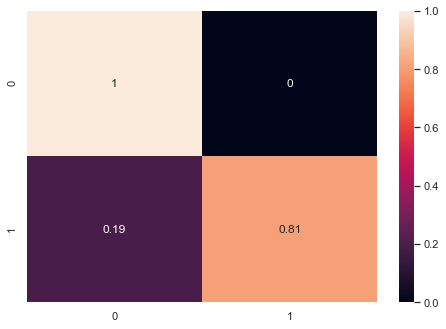



========================= NR_RTR_PORT_10 ======================




Accuracy Score:


  Accuracy:  78.12 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.78      0.88      2016

    accuracy                           0.78      2016
   macro avg       0.50      0.39      0.44      2016
weighted avg       1.00      0.78      0.88      2016



Confusion Matrix:


[[   0    0]
 [ 441 1575]]


Confusion Matrix with Heat MAP:




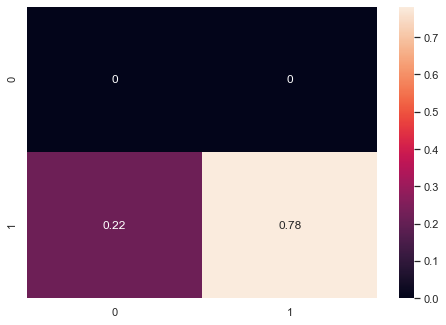



========================= NR_RTR_PORT_11 ======================




Accuracy Score:


  Accuracy:  63.84 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.64      0.78      2016

    accuracy                           0.64      2016
   macro avg       0.50      0.32      0.39      2016
weighted avg       1.00      0.64      0.78      2016



Confusion Matrix:


[[   0    0]
 [ 729 1287]]


Confusion Matrix with Heat MAP:




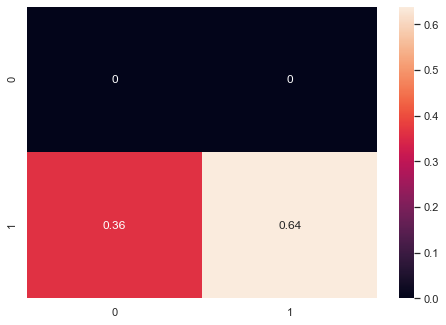



========================= NR_RTR_PORT_12 ======================




Accuracy Score:


  Accuracy:  72.82 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.73      0.84      2016

    accuracy                           0.73      2016
   macro avg       0.50      0.36      0.42      2016
weighted avg       1.00      0.73      0.84      2016



Confusion Matrix:


[[   0    0]
 [ 548 1468]]


Confusion Matrix with Heat MAP:




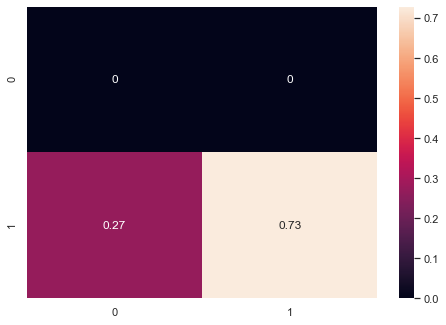



========================= NR_RTR_PORT_13 ======================




Accuracy Score:


  Accuracy:  79.27 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.79      0.88      2016

    accuracy                           0.79      2016
   macro avg       0.50      0.40      0.44      2016
weighted avg       1.00      0.79      0.88      2016



Confusion Matrix:


[[   0    0]
 [ 418 1598]]


Confusion Matrix with Heat MAP:




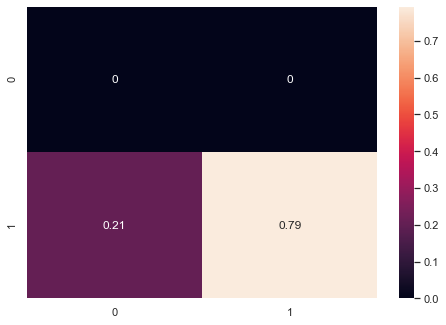



========================= NR_RTR_PORT_14 ======================




Accuracy Score:


  Accuracy:  65.13 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.65      0.79      2016

    accuracy                           0.65      2016
   macro avg       0.50      0.33      0.39      2016
weighted avg       1.00      0.65      0.79      2016



Confusion Matrix:


[[   0    0]
 [ 703 1313]]


Confusion Matrix with Heat MAP:




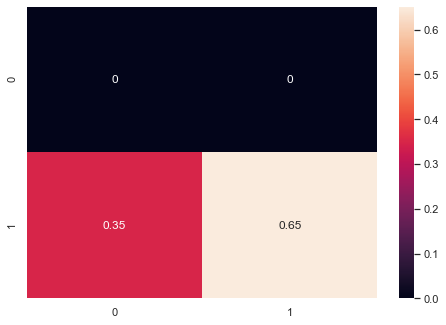



========================= NR_RTR_PORT_15 ======================




Accuracy Score:


  Accuracy:  68.3 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.68      0.81      2016

    accuracy                           0.68      2016
   macro avg       0.50      0.34      0.41      2016
weighted avg       1.00      0.68      0.81      2016



Confusion Matrix:


[[   0    0]
 [ 639 1377]]


Confusion Matrix with Heat MAP:




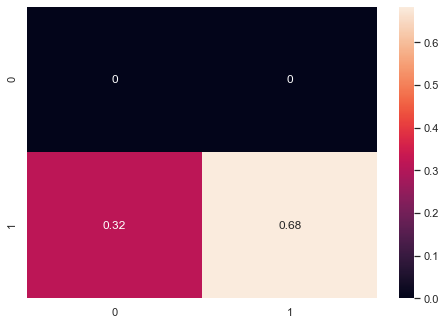



========================= NR_RTR_PORT_16 ======================




Accuracy Score:


  Accuracy:  73.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.74      0.85      2016

    accuracy                           0.74      2016
   macro avg       0.50      0.37      0.42      2016
weighted avg       1.00      0.74      0.85      2016



Confusion Matrix:


[[   0    0]
 [ 527 1489]]


Confusion Matrix with Heat MAP:




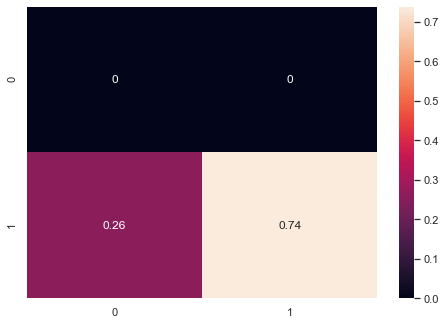



========================= NR_RTR_PORT_17 ======================




Accuracy Score:


  Accuracy:  67.31 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.67      0.80      2016

    accuracy                           0.67      2016
   macro avg       0.50      0.34      0.40      2016
weighted avg       1.00      0.67      0.80      2016



Confusion Matrix:


[[   0    0]
 [ 659 1357]]


Confusion Matrix with Heat MAP:




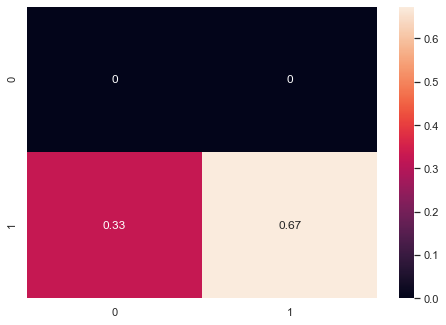



========================= NR_RTR_PORT_18 ======================




Accuracy Score:


  Accuracy:  65.62 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.66      0.79      2016

    accuracy                           0.66      2016
   macro avg       0.50      0.33      0.40      2016
weighted avg       1.00      0.66      0.79      2016



Confusion Matrix:


[[   0    0]
 [ 693 1323]]


Confusion Matrix with Heat MAP:




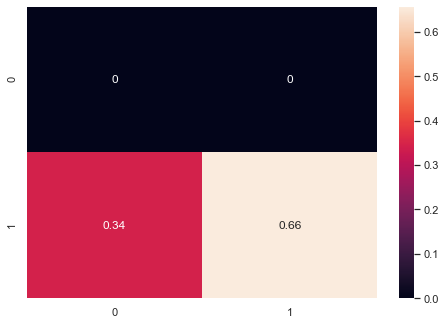



========================= NR_RTR_PORT_19 ======================




Accuracy Score:


  Accuracy:  74.45 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.74      0.85      2016

    accuracy                           0.74      2016
   macro avg       0.50      0.37      0.43      2016
weighted avg       1.00      0.74      0.85      2016



Confusion Matrix:


[[   0    0]
 [ 515 1501]]


Confusion Matrix with Heat MAP:




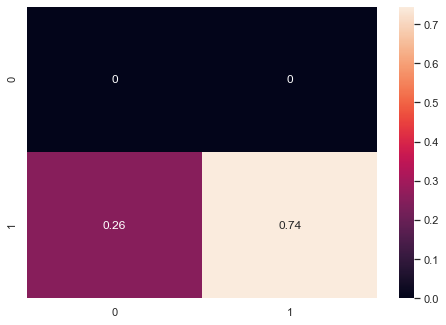



========================= NR_RTR_PORT_20 ======================




Accuracy Score:


  Accuracy:  66.37 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         5
           1       1.00      0.66      0.80      2011

    accuracy                           0.66      2016
   macro avg       0.50      0.83      0.41      2016
weighted avg       1.00      0.66      0.80      2016



Confusion Matrix:


[[   5    0]
 [ 678 1333]]


Confusion Matrix with Heat MAP:




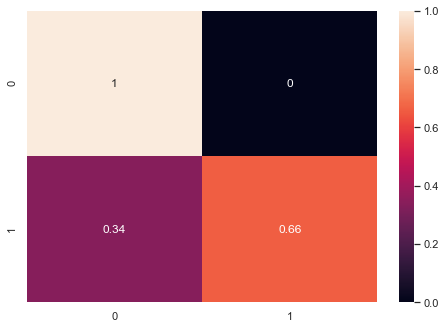

In [30]:
accuracy_1 = dict()
for i in range(20):
    
    print("\n\n ========================================================")
    print("========================= NR_RTR_PORT_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier1.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_1[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_1[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.3: Autoencoder Outlier Detection



========================= NR_RTR_PORT_1 ======================




Accuracy Score:


  Accuracy:  82.94 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.83      0.91      2016

    accuracy                           0.83      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.83      0.91      2016



Confusion Matrix:


[[   0    0]
 [ 344 1672]]


Confusion Matrix with Heat MAP:




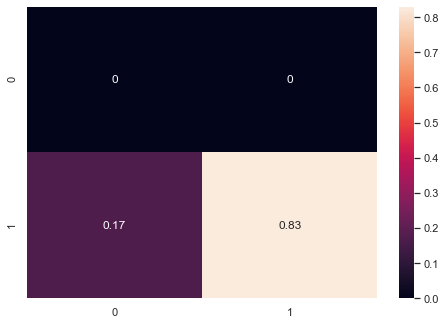



========================= NR_RTR_PORT_2 ======================




Accuracy Score:


  Accuracy:  83.58 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.05      1.00      0.09        16
           1       1.00      0.83      0.91      2000

    accuracy                           0.84      2016
   macro avg       0.52      0.92      0.50      2016
weighted avg       0.99      0.84      0.90      2016



Confusion Matrix:


[[  16    0]
 [ 331 1669]]


Confusion Matrix with Heat MAP:




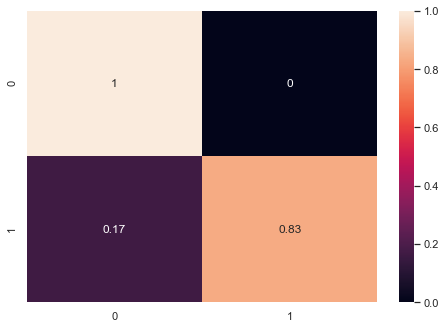



========================= NR_RTR_PORT_3 ======================




Accuracy Score:


  Accuracy:  81.75 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.82      0.90      2016

    accuracy                           0.82      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.82      0.90      2016



Confusion Matrix:


[[   0    0]
 [ 368 1648]]


Confusion Matrix with Heat MAP:




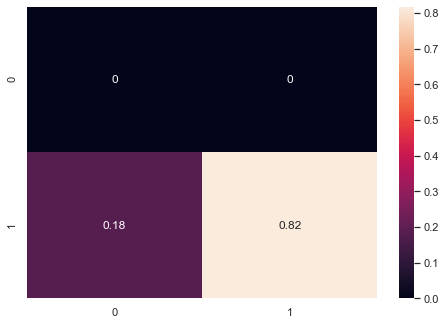



========================= NR_RTR_PORT_4 ======================




Accuracy Score:


  Accuracy:  82.59 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.83      0.90      2016

    accuracy                           0.83      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.83      0.90      2016



Confusion Matrix:


[[   0    0]
 [ 351 1665]]


Confusion Matrix with Heat MAP:




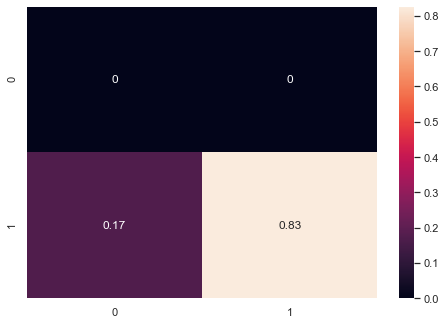



========================= NR_RTR_PORT_5 ======================




Accuracy Score:


  Accuracy:  85.62 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.86      0.92      2016

    accuracy                           0.86      2016
   macro avg       0.50      0.43      0.46      2016
weighted avg       1.00      0.86      0.92      2016



Confusion Matrix:


[[   0    0]
 [ 290 1726]]


Confusion Matrix with Heat MAP:




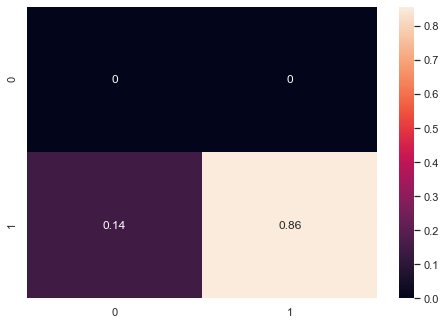



========================= NR_RTR_PORT_6 ======================




Accuracy Score:


  Accuracy:  80.41 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.80      0.89      2016

    accuracy                           0.80      2016
   macro avg       0.50      0.40      0.45      2016
weighted avg       1.00      0.80      0.89      2016



Confusion Matrix:


[[   0    0]
 [ 395 1621]]


Confusion Matrix with Heat MAP:




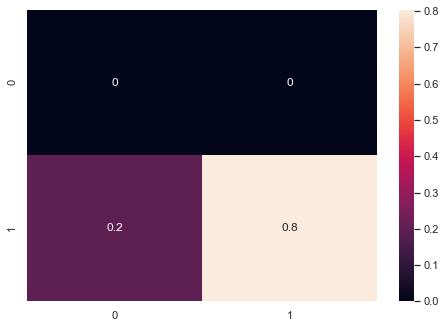



========================= NR_RTR_PORT_7 ======================




Accuracy Score:


  Accuracy:  84.47 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.84      0.92      2016

    accuracy                           0.84      2016
   macro avg       0.50      0.42      0.46      2016
weighted avg       1.00      0.84      0.92      2016



Confusion Matrix:


[[   0    0]
 [ 313 1703]]


Confusion Matrix with Heat MAP:




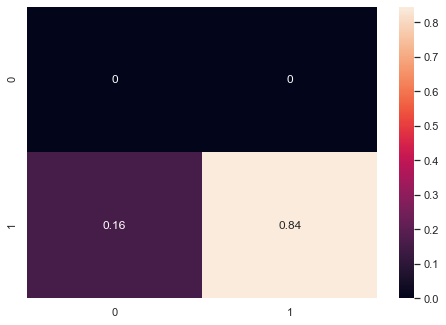



========================= NR_RTR_PORT_8 ======================




Accuracy Score:


  Accuracy:  80.16 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.80      0.89      2016

    accuracy                           0.80      2016
   macro avg       0.50      0.40      0.44      2016
weighted avg       1.00      0.80      0.89      2016



Confusion Matrix:


[[   0    0]
 [ 400 1616]]


Confusion Matrix with Heat MAP:




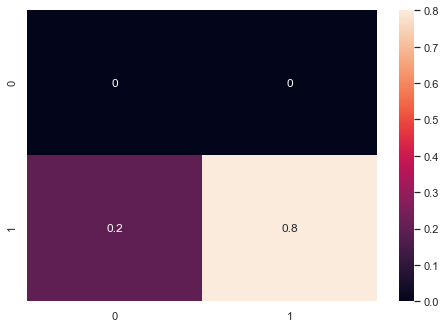



========================= NR_RTR_PORT_9 ======================




Accuracy Score:


  Accuracy:  85.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         1
           1       1.00      0.85      0.92      2015

    accuracy                           0.85      2016
   macro avg       0.50      0.93      0.46      2016
weighted avg       1.00      0.85      0.92      2016



Confusion Matrix:


[[   1    0]
 [ 294 1721]]


Confusion Matrix with Heat MAP:




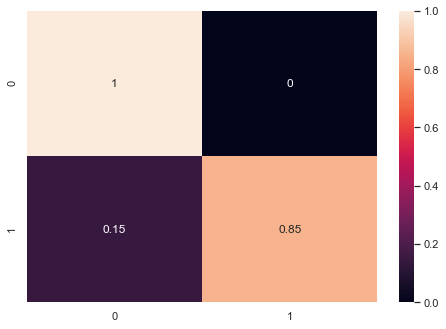



========================= NR_RTR_PORT_10 ======================




Accuracy Score:


  Accuracy:  81.3 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.81      0.90      2016

    accuracy                           0.81      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.81      0.90      2016



Confusion Matrix:


[[   0    0]
 [ 377 1639]]


Confusion Matrix with Heat MAP:




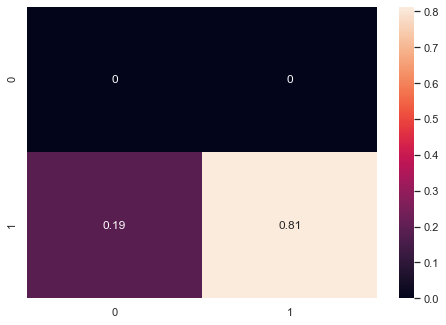



========================= NR_RTR_PORT_11 ======================




Accuracy Score:


  Accuracy:  82.89 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.83      0.91      2016

    accuracy                           0.83      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.83      0.91      2016



Confusion Matrix:


[[   0    0]
 [ 345 1671]]


Confusion Matrix with Heat MAP:




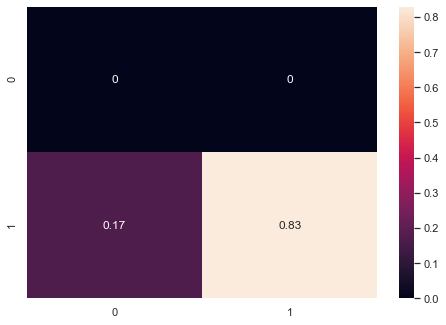



========================= NR_RTR_PORT_12 ======================




Accuracy Score:


  Accuracy:  84.38 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.84      0.92      2016

    accuracy                           0.84      2016
   macro avg       0.50      0.42      0.46      2016
weighted avg       1.00      0.84      0.92      2016



Confusion Matrix:


[[   0    0]
 [ 315 1701]]


Confusion Matrix with Heat MAP:




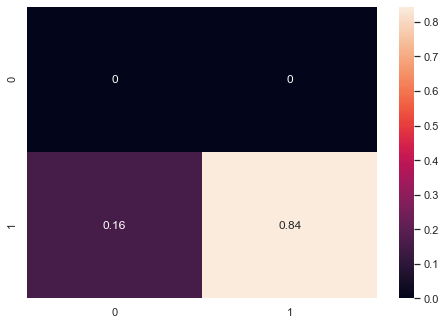



========================= NR_RTR_PORT_13 ======================




Accuracy Score:


  Accuracy:  84.87 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.85      0.92      2016

    accuracy                           0.85      2016
   macro avg       0.50      0.42      0.46      2016
weighted avg       1.00      0.85      0.92      2016



Confusion Matrix:


[[   0    0]
 [ 305 1711]]


Confusion Matrix with Heat MAP:




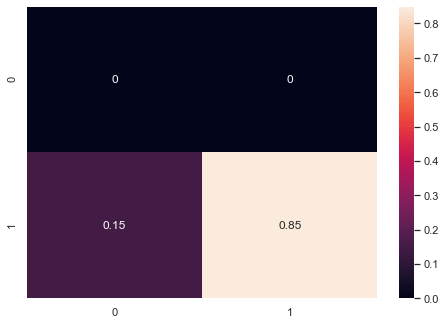



========================= NR_RTR_PORT_14 ======================




Accuracy Score:


  Accuracy:  84.97 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.85      0.92      2016

    accuracy                           0.85      2016
   macro avg       0.50      0.42      0.46      2016
weighted avg       1.00      0.85      0.92      2016



Confusion Matrix:


[[   0    0]
 [ 303 1713]]


Confusion Matrix with Heat MAP:




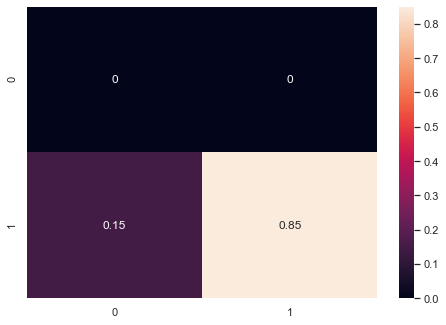



========================= NR_RTR_PORT_15 ======================




Accuracy Score:


  Accuracy:  81.05 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.81      0.90      2016

    accuracy                           0.81      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.81      0.90      2016



Confusion Matrix:


[[   0    0]
 [ 382 1634]]


Confusion Matrix with Heat MAP:




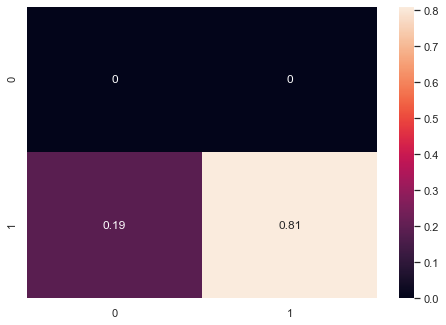



========================= NR_RTR_PORT_16 ======================




Accuracy Score:


  Accuracy:  80.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.80      0.89      2016

    accuracy                           0.80      2016
   macro avg       0.50      0.40      0.44      2016
weighted avg       1.00      0.80      0.89      2016



Confusion Matrix:


[[   0    0]
 [ 401 1615]]


Confusion Matrix with Heat MAP:




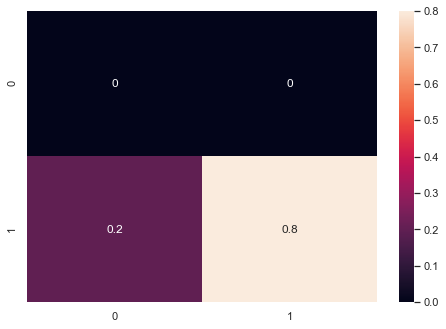



========================= NR_RTR_PORT_17 ======================




Accuracy Score:


  Accuracy:  82.29 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.82      0.90      2016

    accuracy                           0.82      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.82      0.90      2016



Confusion Matrix:


[[   0    0]
 [ 357 1659]]


Confusion Matrix with Heat MAP:




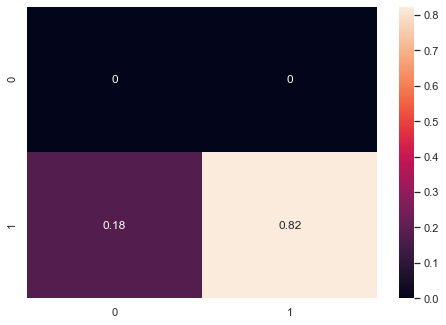



========================= NR_RTR_PORT_18 ======================




Accuracy Score:


  Accuracy:  82.94 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.83      0.91      2016

    accuracy                           0.83      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.83      0.91      2016



Confusion Matrix:


[[   0    0]
 [ 344 1672]]


Confusion Matrix with Heat MAP:




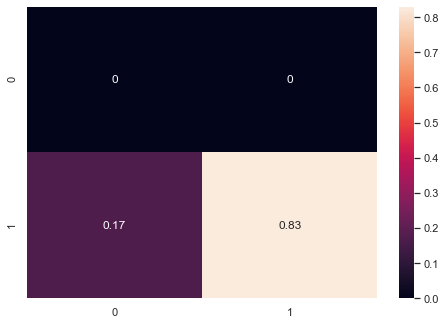



========================= NR_RTR_PORT_19 ======================




Accuracy Score:


  Accuracy:  82.34 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.82      0.90      2016

    accuracy                           0.82      2016
   macro avg       0.50      0.41      0.45      2016
weighted avg       1.00      0.82      0.90      2016



Confusion Matrix:


[[   0    0]
 [ 356 1660]]


Confusion Matrix with Heat MAP:




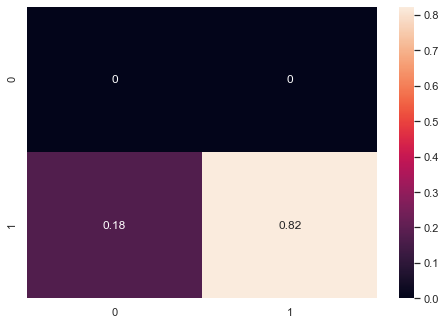



========================= NR_RTR_PORT_20 ======================




Accuracy Score:


  Accuracy:  84.18 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.03         5
           1       1.00      0.84      0.91      2011

    accuracy                           0.84      2016
   macro avg       0.51      0.92      0.47      2016
weighted avg       1.00      0.84      0.91      2016



Confusion Matrix:


[[   5    0]
 [ 319 1692]]


Confusion Matrix with Heat MAP:




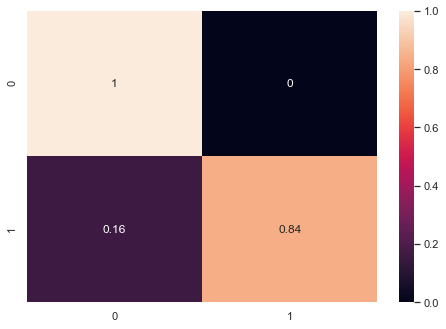

In [31]:
accuracy_2 = dict()
for i in range(20):
    
    print("\n\n ========================================================")
    print("========================= NR_RTR_PORT_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier2.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_2[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_2[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.4: Local Outlier Factor Outlier Detection



========================= NR_RTR_PORT_1 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      2016

    accuracy                           1.00      2016
   macro avg       1.00      1.00      1.00      2016
weighted avg       1.00      1.00      1.00      2016



Confusion Matrix:


[[2016]]


Confusion Matrix with Heat MAP:




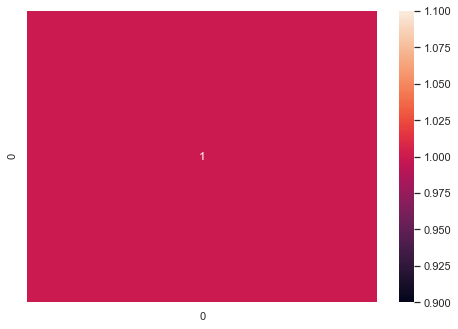



========================= NR_RTR_PORT_2 ======================




Accuracy Score:


  Accuracy:  99.31 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.60      0.38      0.46        16
           1       1.00      1.00      1.00      2000

    accuracy                           0.99      2016
   macro avg       0.80      0.69      0.73      2016
weighted avg       0.99      0.99      0.99      2016



Confusion Matrix:


[[   6   10]
 [   4 1996]]


Confusion Matrix with Heat MAP:




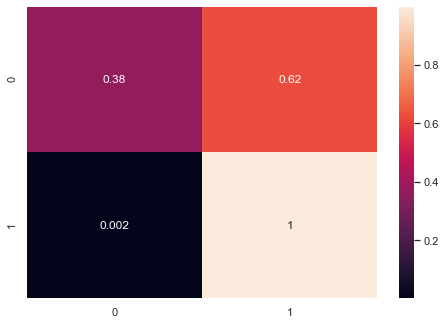



========================= NR_RTR_PORT_3 ======================




Accuracy Score:


  Accuracy:  98.46 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.98      0.99      2016

    accuracy                           0.98      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.98      0.99      2016



Confusion Matrix:


[[   0    0]
 [  31 1985]]


Confusion Matrix with Heat MAP:




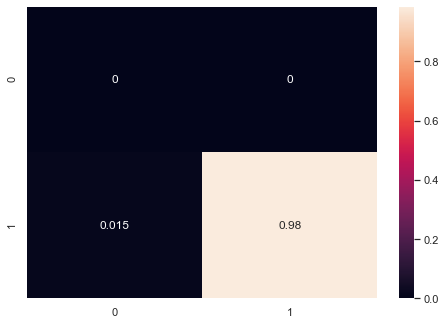



========================= NR_RTR_PORT_4 ======================




Accuracy Score:


  Accuracy:  99.06 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  19 1997]]


Confusion Matrix with Heat MAP:




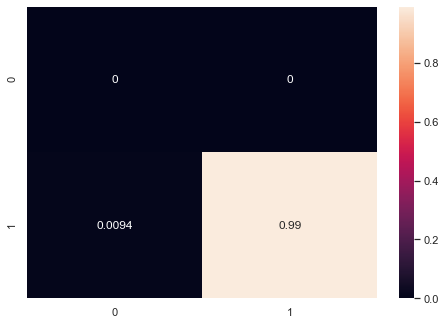



========================= NR_RTR_PORT_5 ======================




Accuracy Score:


  Accuracy:  99.21 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  16 2000]]


Confusion Matrix with Heat MAP:




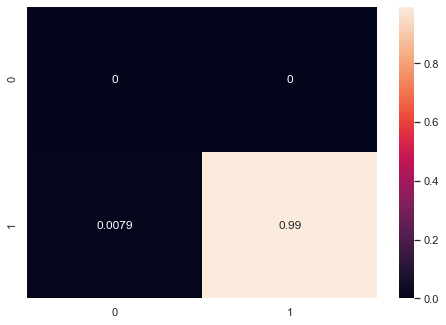



========================= NR_RTR_PORT_6 ======================




Accuracy Score:


  Accuracy:  98.71 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  26 1990]]


Confusion Matrix with Heat MAP:




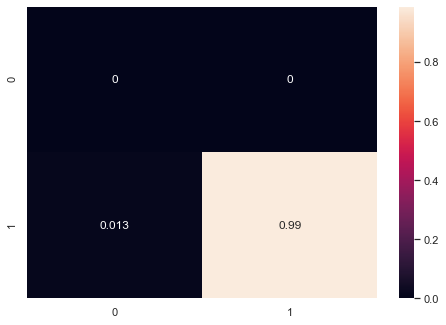



========================= NR_RTR_PORT_7 ======================




Accuracy Score:


  Accuracy:  99.36 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  13 2003]]


Confusion Matrix with Heat MAP:




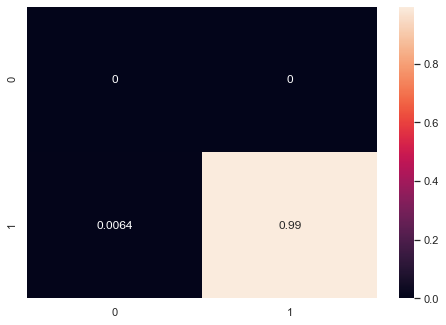



========================= NR_RTR_PORT_8 ======================




Accuracy Score:


  Accuracy:  99.4 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  12 2004]]


Confusion Matrix with Heat MAP:




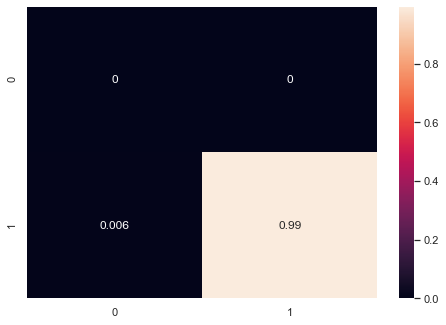



========================= NR_RTR_PORT_9 ======================




Accuracy Score:


  Accuracy:  99.45 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.08      1.00      0.15         1
           1       1.00      0.99      1.00      2015

    accuracy                           0.99      2016
   macro avg       0.54      1.00      0.58      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   1    0]
 [  11 2004]]


Confusion Matrix with Heat MAP:




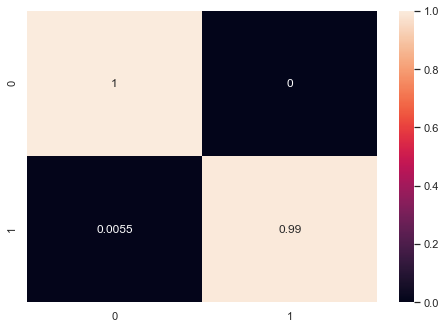



========================= NR_RTR_PORT_10 ======================




Accuracy Score:


  Accuracy:  99.01 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  20 1996]]


Confusion Matrix with Heat MAP:




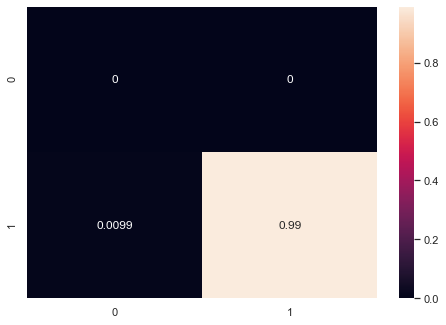



========================= NR_RTR_PORT_11 ======================




Accuracy Score:


  Accuracy:  99.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  18 1998]]


Confusion Matrix with Heat MAP:




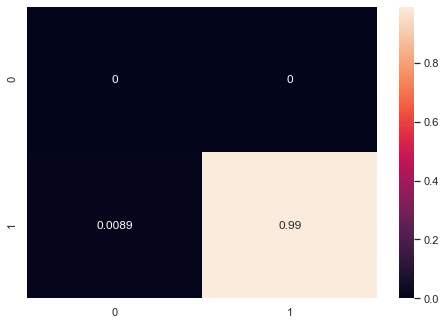



========================= NR_RTR_PORT_12 ======================




Accuracy Score:


  Accuracy:  99.01 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  20 1996]]


Confusion Matrix with Heat MAP:




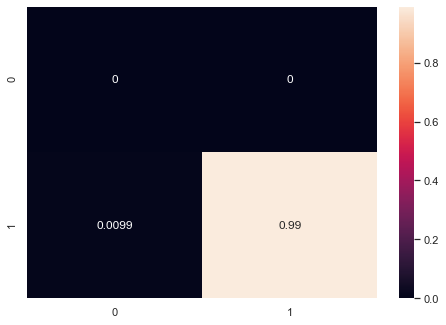



========================= NR_RTR_PORT_13 ======================




Accuracy Score:


  Accuracy:  98.91 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  22 1994]]


Confusion Matrix with Heat MAP:




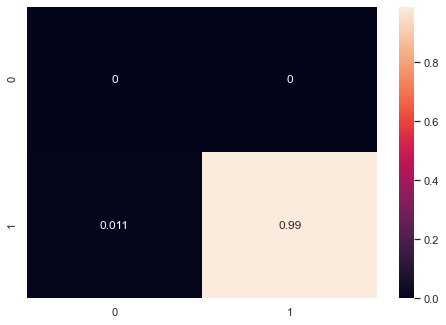



========================= NR_RTR_PORT_14 ======================




Accuracy Score:


  Accuracy:  99.26 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  15 2001]]


Confusion Matrix with Heat MAP:




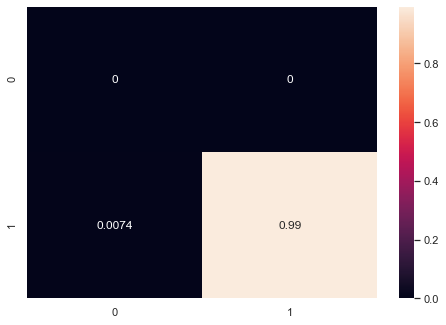



========================= NR_RTR_PORT_15 ======================




Accuracy Score:


  Accuracy:  99.4 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  12 2004]]


Confusion Matrix with Heat MAP:




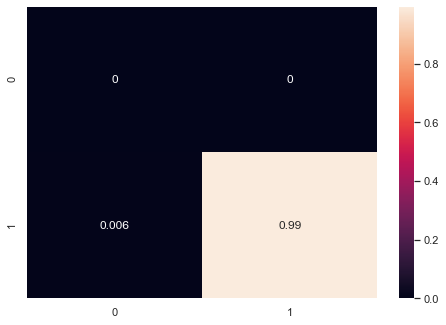



========================= NR_RTR_PORT_16 ======================




Accuracy Score:


  Accuracy:  99.45 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  11 2005]]


Confusion Matrix with Heat MAP:




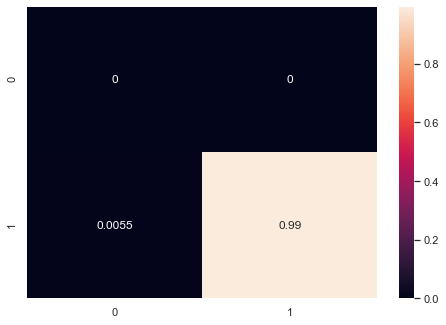



========================= NR_RTR_PORT_17 ======================




Accuracy Score:


  Accuracy:  99.4 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  12 2004]]


Confusion Matrix with Heat MAP:




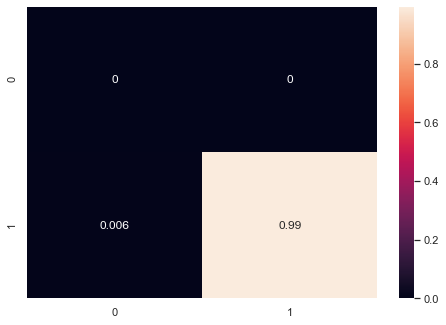



========================= NR_RTR_PORT_18 ======================




Accuracy Score:


  Accuracy:  99.31 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  14 2002]]


Confusion Matrix with Heat MAP:




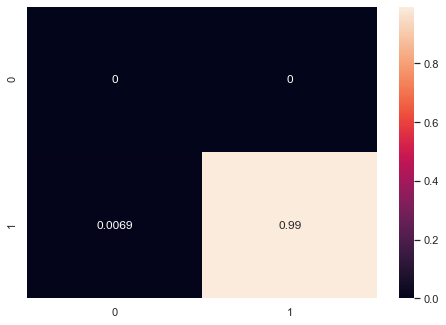



========================= NR_RTR_PORT_19 ======================




Accuracy Score:


  Accuracy:  99.31 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  14 2002]]


Confusion Matrix with Heat MAP:




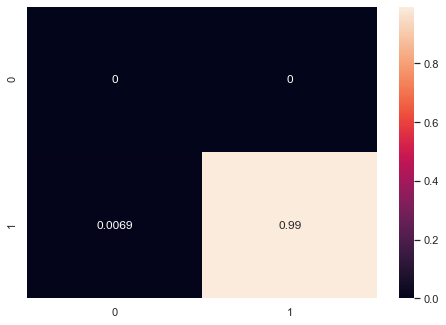



========================= NR_RTR_PORT_20 ======================




Accuracy Score:


  Accuracy:  99.55 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.17      0.20      0.18         5
           1       1.00      1.00      1.00      2011

    accuracy                           1.00      2016
   macro avg       0.58      0.60      0.59      2016
weighted avg       1.00      1.00      1.00      2016



Confusion Matrix:


[[   1    4]
 [   5 2006]]


Confusion Matrix with Heat MAP:




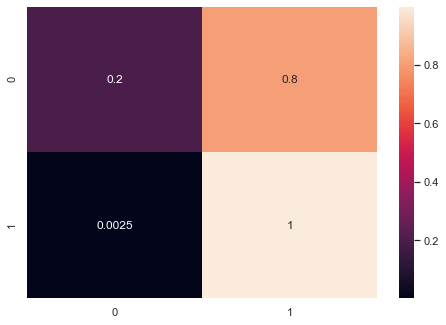

In [32]:
accuracy_3 = dict()
for i in range(20):
    
    print("\n\n ========================================================")
    print("========================= NR_RTR_PORT_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier3.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_3[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_3[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.5: One Class SVM Outlier Detection



========================= NR_RTR_PORT_1 ======================




Accuracy Score:


  Accuracy:  49.95 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1009 1007]]


Confusion Matrix with Heat MAP:




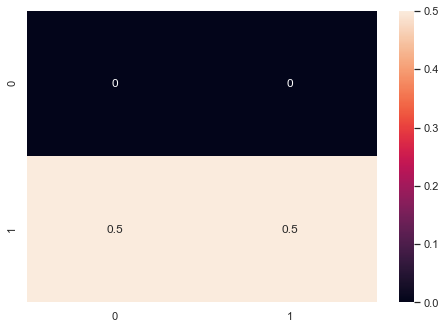



========================= NR_RTR_PORT_2 ======================




Accuracy Score:


  Accuracy:  50.79 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.03        16
           1       1.00      0.50      0.67      2000

    accuracy                           0.51      2016
   macro avg       0.51      0.75      0.35      2016
weighted avg       0.99      0.51      0.67      2016



Confusion Matrix:


[[  16    0]
 [ 992 1008]]


Confusion Matrix with Heat MAP:




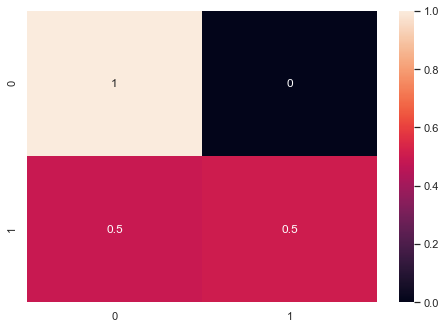



========================= NR_RTR_PORT_3 ======================




Accuracy Score:


  Accuracy:  50.15 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1005 1011]]


Confusion Matrix with Heat MAP:




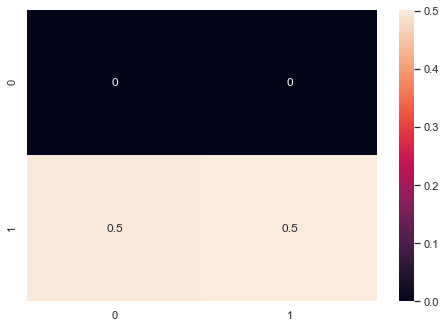



========================= NR_RTR_PORT_4 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1008 1008]]


Confusion Matrix with Heat MAP:




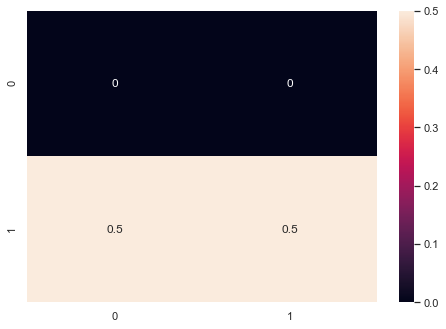



========================= NR_RTR_PORT_5 ======================




Accuracy Score:


  Accuracy:  49.9 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1010 1006]]


Confusion Matrix with Heat MAP:




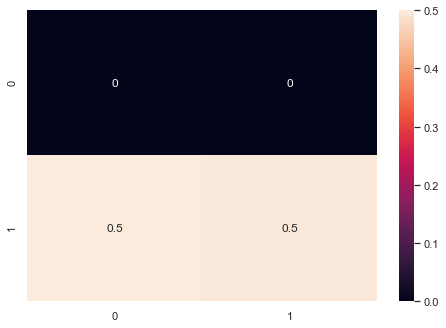



========================= NR_RTR_PORT_6 ======================




Accuracy Score:


  Accuracy:  50.05 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1007 1009]]


Confusion Matrix with Heat MAP:




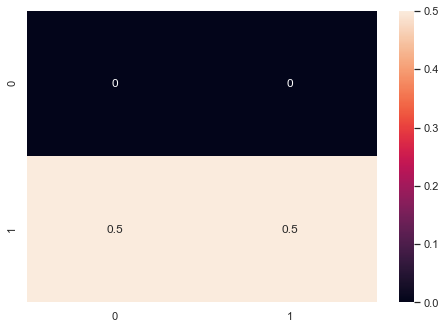



========================= NR_RTR_PORT_7 ======================




Accuracy Score:


  Accuracy:  50.05 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1007 1009]]


Confusion Matrix with Heat MAP:




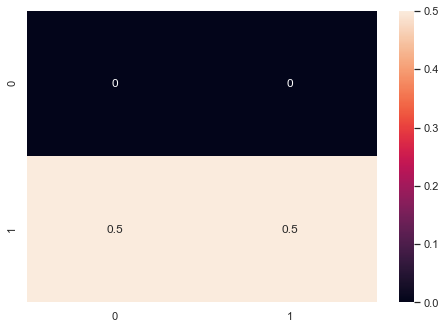



========================= NR_RTR_PORT_8 ======================




Accuracy Score:


  Accuracy:  50.05 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1007 1009]]


Confusion Matrix with Heat MAP:




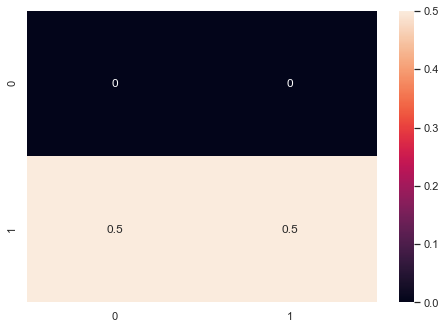



========================= NR_RTR_PORT_9 ======================




Accuracy Score:


  Accuracy:  50.15 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.00         1
           1       1.00      0.50      0.67      2015

    accuracy                           0.50      2016
   macro avg       0.50      0.75      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   1    0]
 [1005 1010]]


Confusion Matrix with Heat MAP:




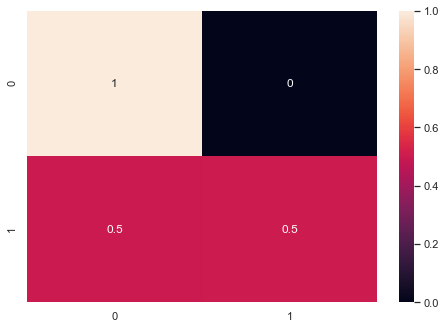



========================= NR_RTR_PORT_10 ======================




Accuracy Score:


  Accuracy:  50.05 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1007 1009]]


Confusion Matrix with Heat MAP:




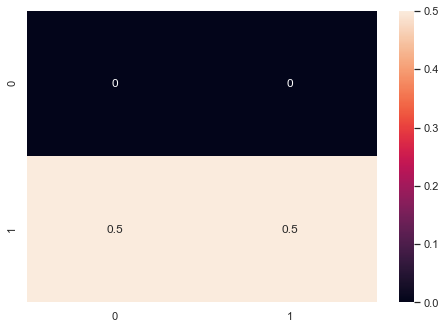



========================= NR_RTR_PORT_11 ======================




Accuracy Score:


  Accuracy:  50.2 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1004 1012]]


Confusion Matrix with Heat MAP:




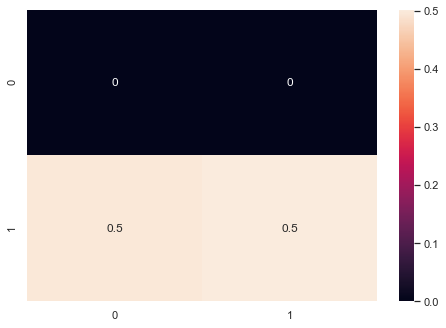



========================= NR_RTR_PORT_12 ======================




Accuracy Score:


  Accuracy:  50.1 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1006 1010]]


Confusion Matrix with Heat MAP:




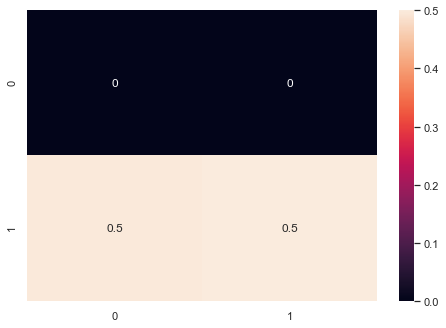



========================= NR_RTR_PORT_13 ======================




Accuracy Score:


  Accuracy:  50.1 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1006 1010]]


Confusion Matrix with Heat MAP:




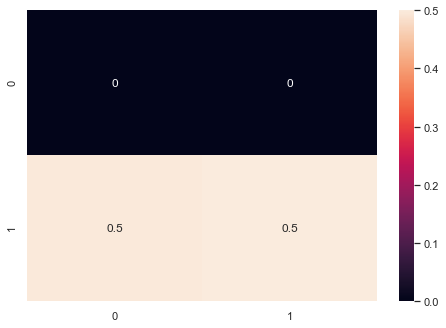



========================= NR_RTR_PORT_14 ======================




Accuracy Score:


  Accuracy:  49.7 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.66      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.66      2016



Confusion Matrix:


[[   0    0]
 [1014 1002]]


Confusion Matrix with Heat MAP:




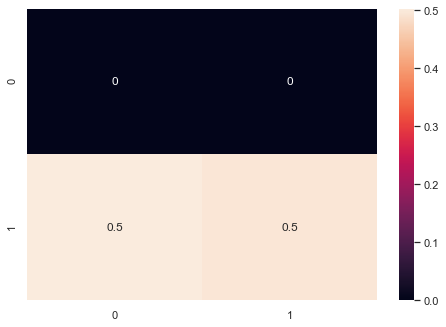



========================= NR_RTR_PORT_15 ======================




Accuracy Score:


  Accuracy:  50.05 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1007 1009]]


Confusion Matrix with Heat MAP:




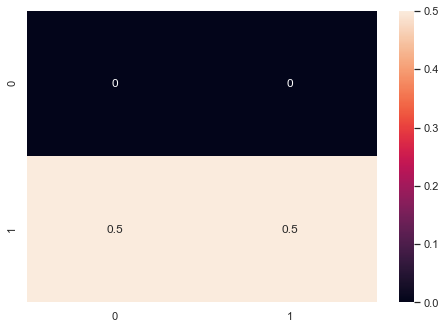



========================= NR_RTR_PORT_16 ======================




Accuracy Score:


  Accuracy:  49.95 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1009 1007]]


Confusion Matrix with Heat MAP:




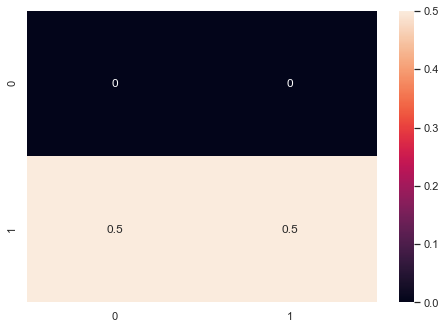



========================= NR_RTR_PORT_17 ======================




Accuracy Score:


  Accuracy:  49.95 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1009 1007]]


Confusion Matrix with Heat MAP:




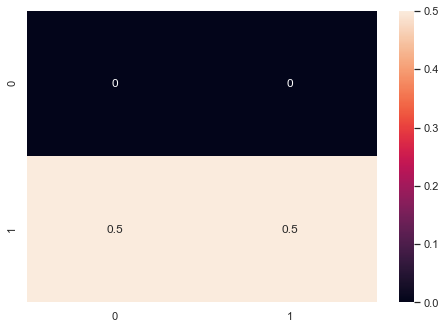



========================= NR_RTR_PORT_18 ======================




Accuracy Score:


  Accuracy:  50.15 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1005 1011]]


Confusion Matrix with Heat MAP:




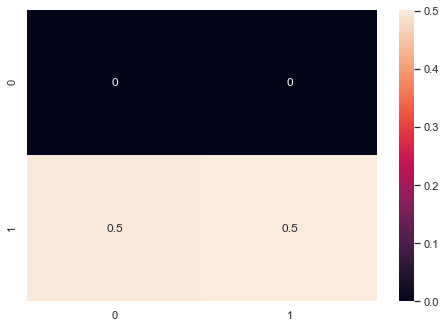



========================= NR_RTR_PORT_19 ======================




Accuracy Score:


  Accuracy:  50.15 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      2016

    accuracy                           0.50      2016
   macro avg       0.50      0.25      0.33      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   0    0]
 [1005 1011]]


Confusion Matrix with Heat MAP:




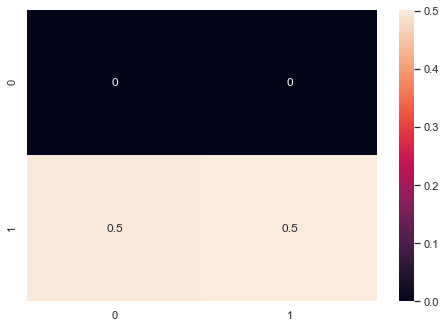



========================= NR_RTR_PORT_20 ======================




Accuracy Score:


  Accuracy:  50.15 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         5
           1       1.00      0.50      0.67      2011

    accuracy                           0.50      2016
   macro avg       0.50      0.75      0.34      2016
weighted avg       1.00      0.50      0.67      2016



Confusion Matrix:


[[   5    0]
 [1005 1006]]


Confusion Matrix with Heat MAP:




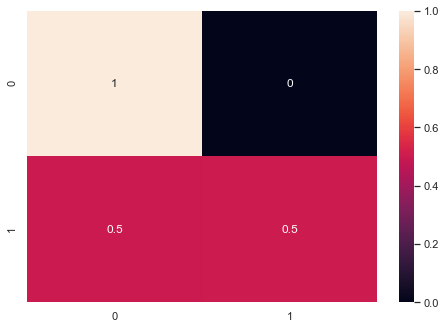

In [33]:
accuracy_4 = dict()
for i in range(20):
    
    print("\n\n ========================================================")
    print("========================= NR_RTR_PORT_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier4.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_4[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_4[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.6: DBSCAN Outlier Detection



========================= NR_RTR_PORT_1 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      2016

    accuracy                           1.00      2016
   macro avg       1.00      1.00      1.00      2016
weighted avg       1.00      1.00      1.00      2016



Confusion Matrix:


[[2016]]


Confusion Matrix with Heat MAP:




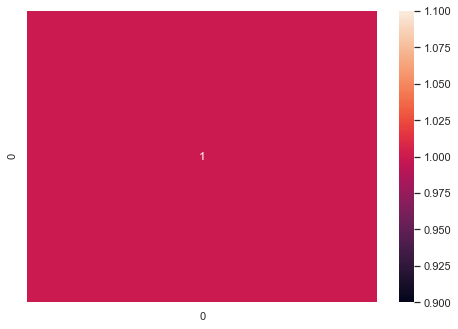



========================= NR_RTR_PORT_2 ======================




Accuracy Score:


  Accuracy:  99.5 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      0.38      0.55        16
           1       1.00      1.00      1.00      2000

    accuracy                           1.00      2016
   macro avg       1.00      0.69      0.77      2016
weighted avg       1.00      1.00      0.99      2016



Confusion Matrix:


[[   6   10]
 [   0 2000]]


Confusion Matrix with Heat MAP:




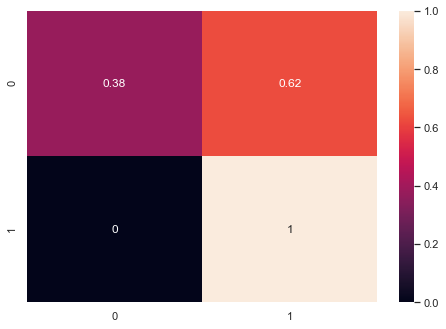



========================= NR_RTR_PORT_3 ======================




Accuracy Score:


  Accuracy:  99.6 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      1.00      1.00      2016

    accuracy                           1.00      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      1.00      1.00      2016



Confusion Matrix:


[[   0    0]
 [   8 2008]]


Confusion Matrix with Heat MAP:




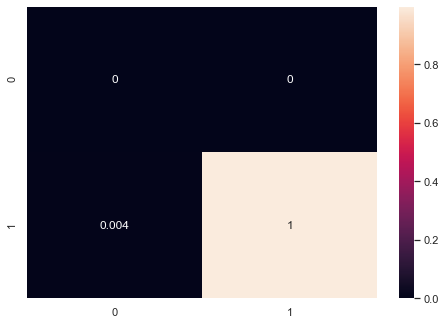



========================= NR_RTR_PORT_4 ======================




Accuracy Score:


  Accuracy:  99.01 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  20 1996]]


Confusion Matrix with Heat MAP:




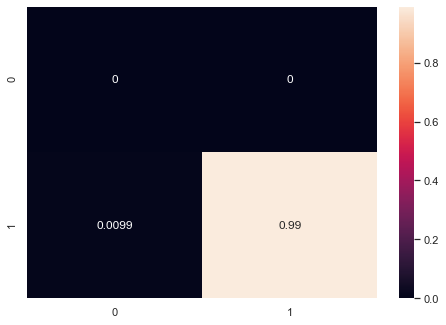



========================= NR_RTR_PORT_5 ======================




Accuracy Score:


  Accuracy:  98.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.98      0.99      2016

    accuracy                           0.98      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.98      0.99      2016



Confusion Matrix:


[[   0    0]
 [  39 1977]]


Confusion Matrix with Heat MAP:




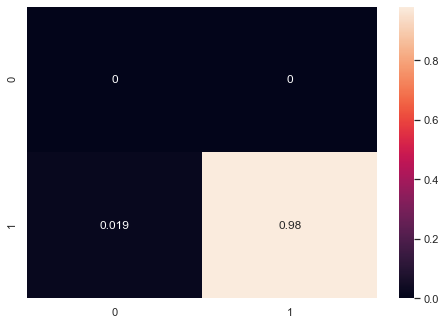



========================= NR_RTR_PORT_6 ======================




Accuracy Score:


  Accuracy:  98.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  23 1993]]


Confusion Matrix with Heat MAP:




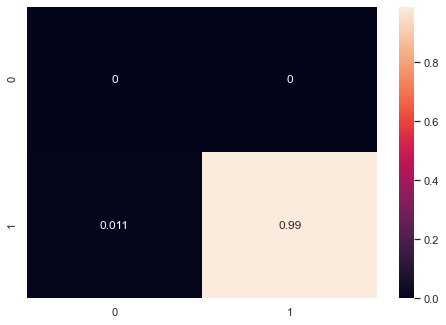



========================= NR_RTR_PORT_7 ======================




Accuracy Score:


  Accuracy:  99.4 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  12 2004]]


Confusion Matrix with Heat MAP:




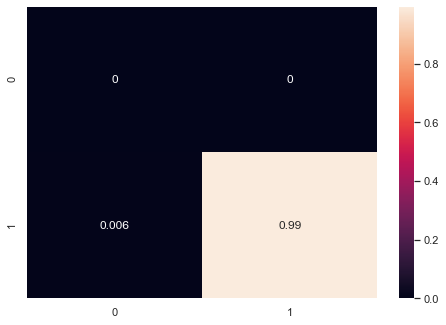



========================= NR_RTR_PORT_8 ======================




Accuracy Score:


  Accuracy:  98.81 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  24 1992]]


Confusion Matrix with Heat MAP:




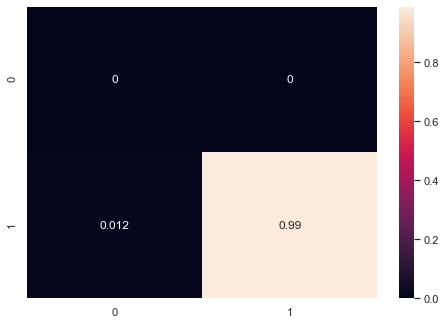



========================= NR_RTR_PORT_9 ======================




Accuracy Score:


  Accuracy:  99.5 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.09      1.00      0.17         1
           1       1.00      1.00      1.00      2015

    accuracy                           1.00      2016
   macro avg       0.55      1.00      0.58      2016
weighted avg       1.00      1.00      1.00      2016



Confusion Matrix:


[[   1    0]
 [  10 2005]]


Confusion Matrix with Heat MAP:




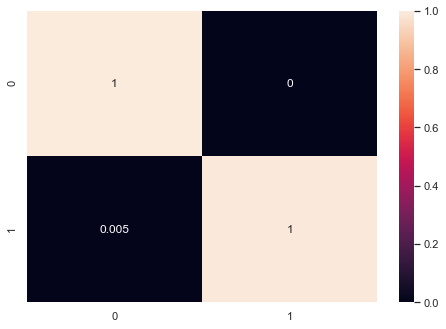



========================= NR_RTR_PORT_10 ======================




Accuracy Score:


  Accuracy:  98.91 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  22 1994]]


Confusion Matrix with Heat MAP:




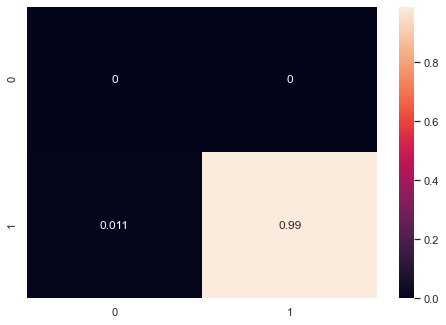



========================= NR_RTR_PORT_11 ======================




Accuracy Score:


  Accuracy:  98.66 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  27 1989]]


Confusion Matrix with Heat MAP:




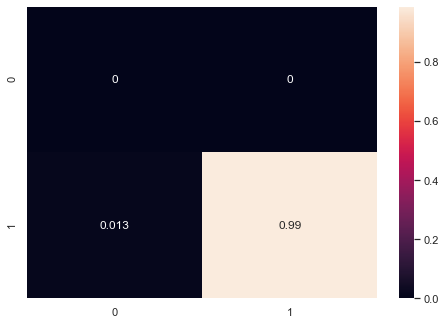



========================= NR_RTR_PORT_12 ======================




Accuracy Score:


  Accuracy:  99.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  18 1998]]


Confusion Matrix with Heat MAP:




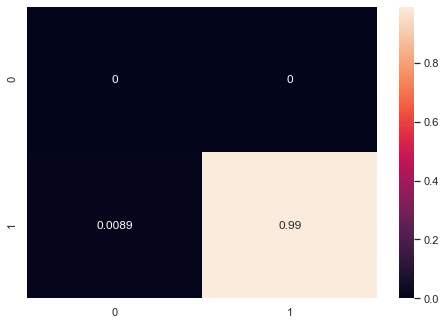



========================= NR_RTR_PORT_13 ======================




Accuracy Score:


  Accuracy:  99.06 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  19 1997]]


Confusion Matrix with Heat MAP:




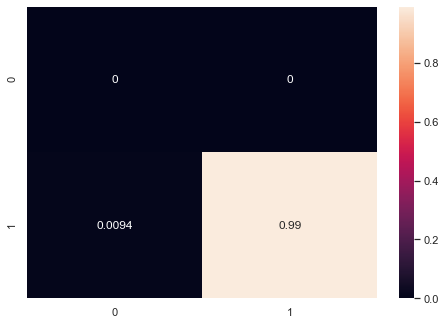



========================= NR_RTR_PORT_14 ======================




Accuracy Score:


  Accuracy:  99.26 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  15 2001]]


Confusion Matrix with Heat MAP:




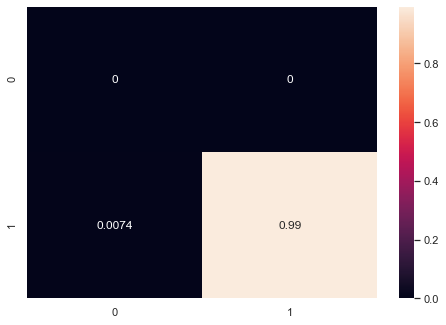



========================= NR_RTR_PORT_15 ======================




Accuracy Score:


  Accuracy:  99.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  18 1998]]


Confusion Matrix with Heat MAP:




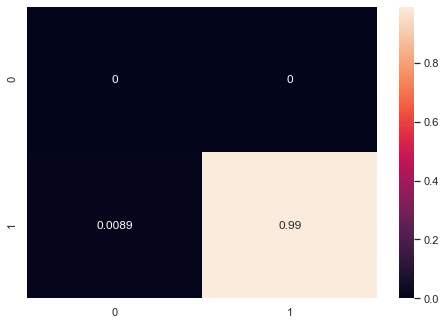



========================= NR_RTR_PORT_16 ======================




Accuracy Score:


  Accuracy:  99.16 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  17 1999]]


Confusion Matrix with Heat MAP:




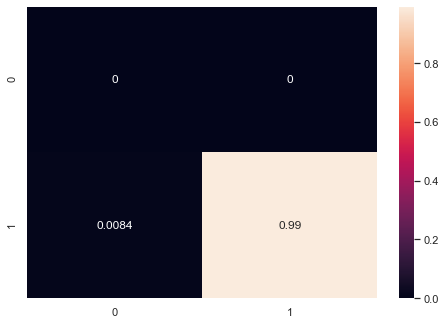



========================= NR_RTR_PORT_17 ======================




Accuracy Score:


  Accuracy:  99.36 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      0.99      1.00      2016



Confusion Matrix:


[[   0    0]
 [  13 2003]]


Confusion Matrix with Heat MAP:




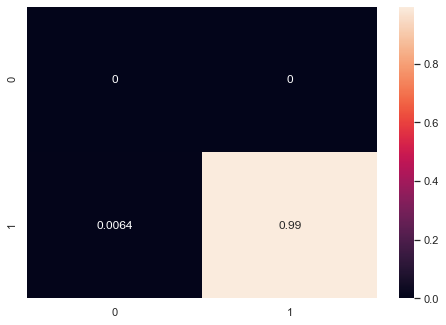



========================= NR_RTR_PORT_18 ======================




Accuracy Score:


  Accuracy:  98.91 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      0.99      2016

    accuracy                           0.99      2016
   macro avg       0.50      0.49      0.50      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   0    0]
 [  22 1994]]


Confusion Matrix with Heat MAP:




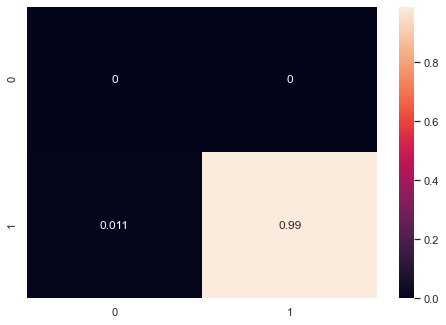



========================= NR_RTR_PORT_19 ======================




Accuracy Score:


  Accuracy:  99.5 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      1.00      1.00      2016

    accuracy                           1.00      2016
   macro avg       0.50      0.50      0.50      2016
weighted avg       1.00      1.00      1.00      2016



Confusion Matrix:


[[   0    0]
 [  10 2006]]


Confusion Matrix with Heat MAP:




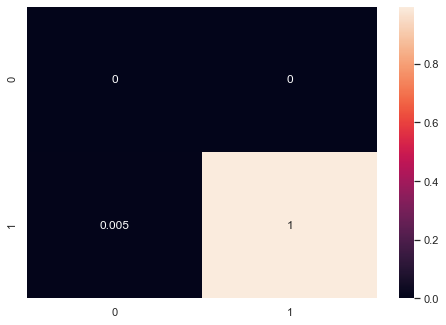



========================= NR_RTR_PORT_20 ======================




Accuracy Score:


  Accuracy:  99.06 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.06      0.20      0.10         5
           1       1.00      0.99      1.00      2011

    accuracy                           0.99      2016
   macro avg       0.53      0.60      0.55      2016
weighted avg       1.00      0.99      0.99      2016



Confusion Matrix:


[[   1    4]
 [  15 1996]]


Confusion Matrix with Heat MAP:




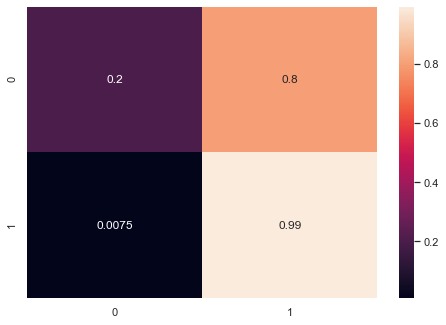

In [34]:
accuracy_5 = dict()
for i in range(20):
    
    print("\n\n ========================================================")
    print("========================= NR_RTR_PORT_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier5.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_5[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_5[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

# Step 7: Comparison of all Models



========================= NR_RTR_PORT_1 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    78.42 %     |
|     Autoencoder      |    82.94 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    49.95 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


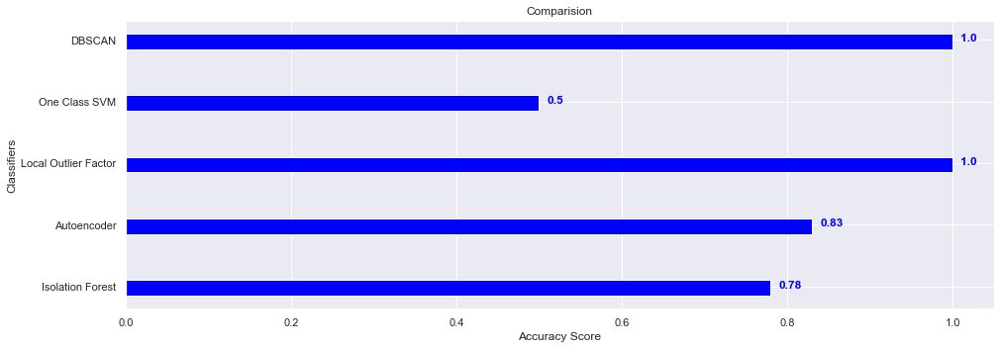



========================= NR_RTR_PORT_2 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    75.99 %     |
|     Autoencoder      |    83.58 %     |
| Local Outlier Factor |    99.31 %     |
|    One Class SVM     |    50.79 %     |
|        DBSCAN        |     99.5 %     |
+----------------------+----------------+


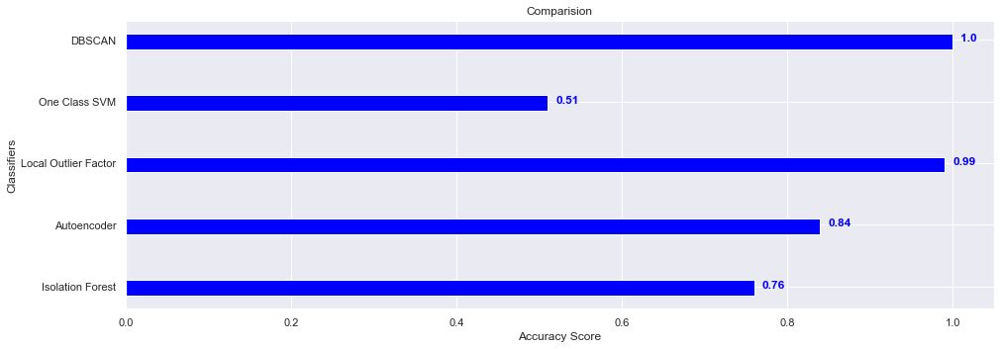



========================= NR_RTR_PORT_3 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    67.61 %     |
|     Autoencoder      |    81.75 %     |
| Local Outlier Factor |    98.46 %     |
|    One Class SVM     |    50.15 %     |
|        DBSCAN        |     99.6 %     |
+----------------------+----------------+


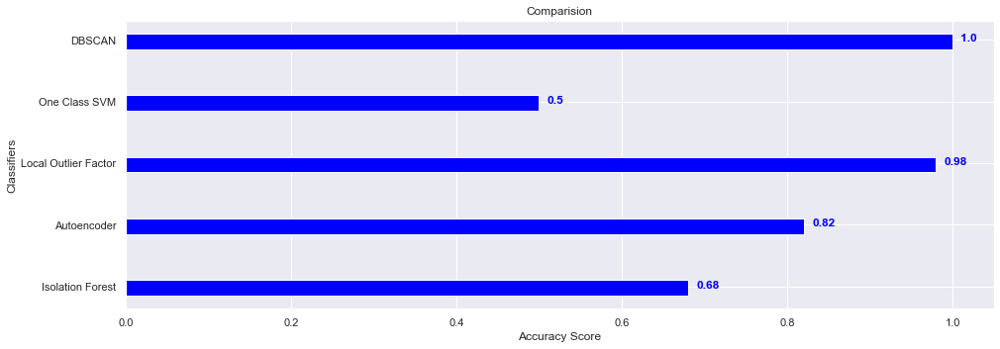



========================= NR_RTR_PORT_4 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    66.72 %     |
|     Autoencoder      |    82.59 %     |
| Local Outlier Factor |    99.06 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    99.01 %     |
+----------------------+----------------+


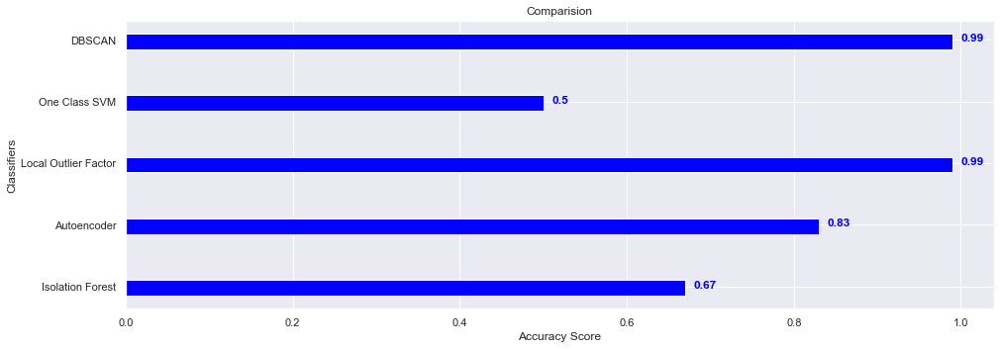



========================= NR_RTR_PORT_5 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    77.18 %     |
|     Autoencoder      |    85.62 %     |
| Local Outlier Factor |    99.21 %     |
|    One Class SVM     |     49.9 %     |
|        DBSCAN        |    98.07 %     |
+----------------------+----------------+


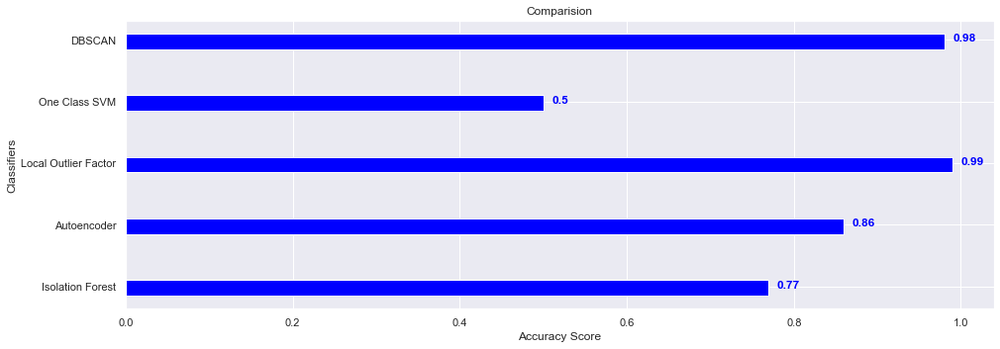



========================= NR_RTR_PORT_6 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    71.63 %     |
|     Autoencoder      |    80.41 %     |
| Local Outlier Factor |    98.71 %     |
|    One Class SVM     |    50.05 %     |
|        DBSCAN        |    98.86 %     |
+----------------------+----------------+


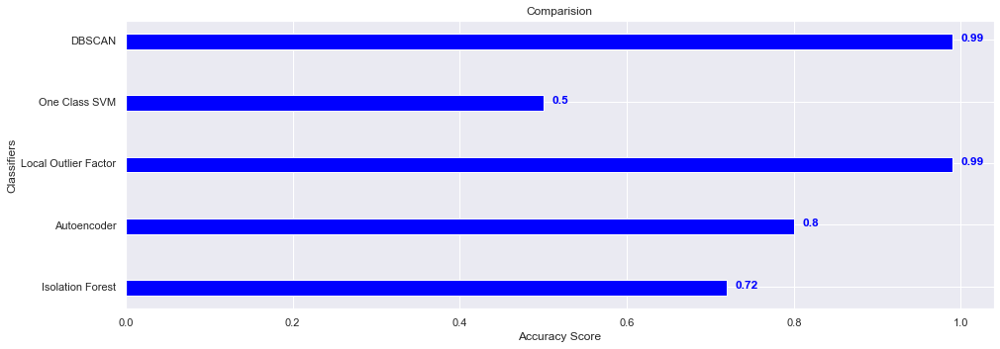



========================= NR_RTR_PORT_7 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    72.42 %     |
|     Autoencoder      |    84.47 %     |
| Local Outlier Factor |    99.36 %     |
|    One Class SVM     |    50.05 %     |
|        DBSCAN        |     99.4 %     |
+----------------------+----------------+


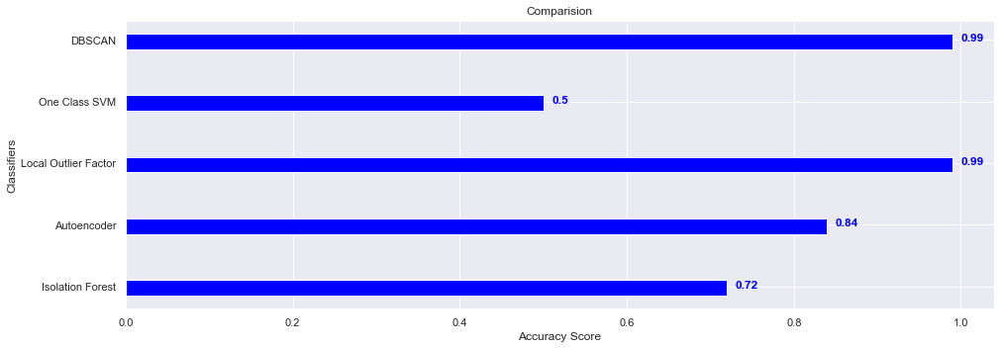



========================= NR_RTR_PORT_8 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    66.42 %     |
|     Autoencoder      |    80.16 %     |
| Local Outlier Factor |     99.4 %     |
|    One Class SVM     |    50.05 %     |
|        DBSCAN        |    98.81 %     |
+----------------------+----------------+


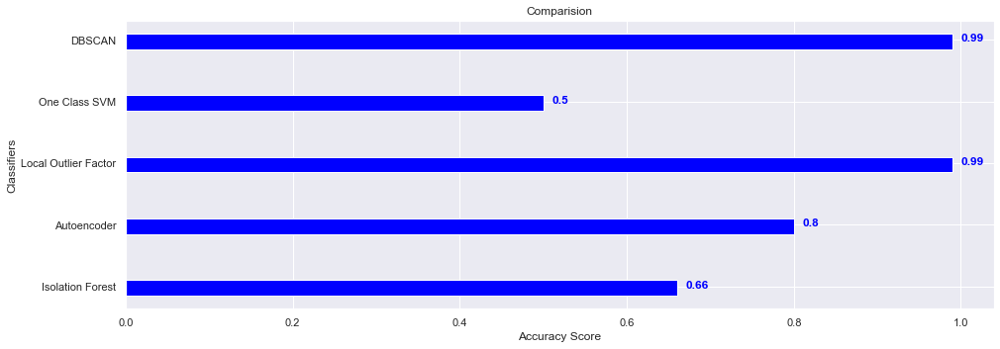



========================= NR_RTR_PORT_9 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     80.7 %     |
|     Autoencoder      |    85.42 %     |
| Local Outlier Factor |    99.45 %     |
|    One Class SVM     |    50.15 %     |
|        DBSCAN        |     99.5 %     |
+----------------------+----------------+


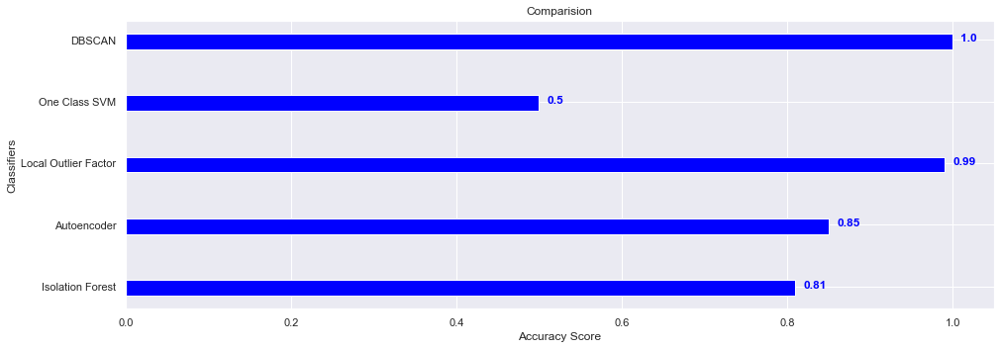



========================= NR_RTR_PORT_10 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    78.12 %     |
|     Autoencoder      |     81.3 %     |
| Local Outlier Factor |    99.01 %     |
|    One Class SVM     |    50.05 %     |
|        DBSCAN        |    98.91 %     |
+----------------------+----------------+


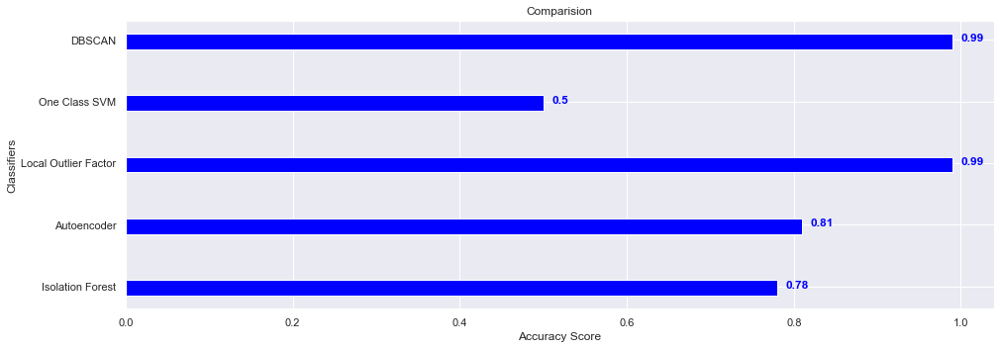



========================= NR_RTR_PORT_11 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    63.84 %     |
|     Autoencoder      |    82.89 %     |
| Local Outlier Factor |    99.11 %     |
|    One Class SVM     |     50.2 %     |
|        DBSCAN        |    98.66 %     |
+----------------------+----------------+


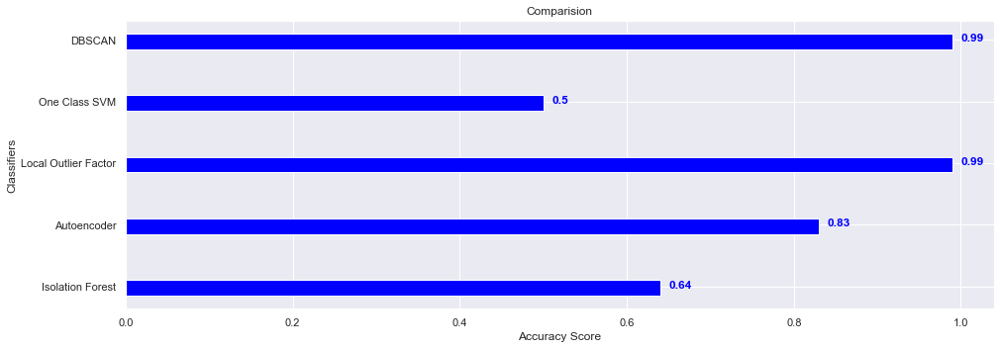



========================= NR_RTR_PORT_12 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    72.82 %     |
|     Autoencoder      |    84.38 %     |
| Local Outlier Factor |    99.01 %     |
|    One Class SVM     |     50.1 %     |
|        DBSCAN        |    99.11 %     |
+----------------------+----------------+


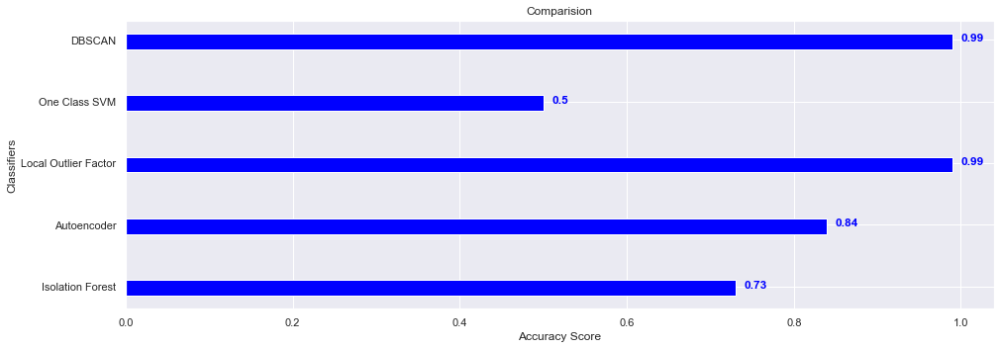



========================= NR_RTR_PORT_13 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    79.27 %     |
|     Autoencoder      |    84.87 %     |
| Local Outlier Factor |    98.91 %     |
|    One Class SVM     |     50.1 %     |
|        DBSCAN        |    99.06 %     |
+----------------------+----------------+


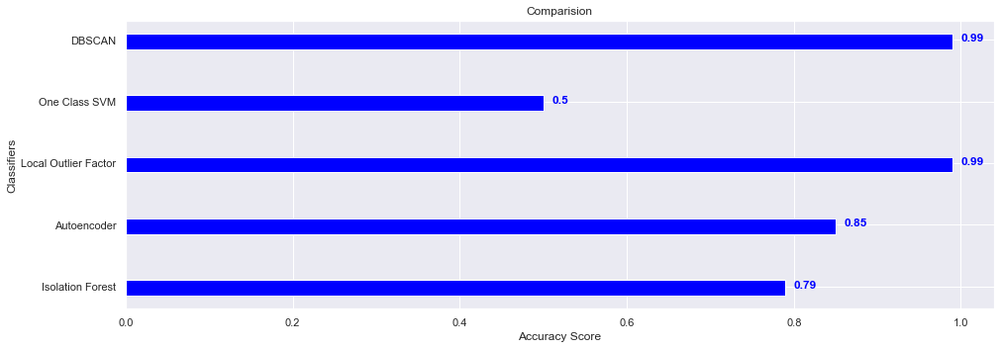



========================= NR_RTR_PORT_14 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    65.13 %     |
|     Autoencoder      |    84.97 %     |
| Local Outlier Factor |    99.26 %     |
|    One Class SVM     |     49.7 %     |
|        DBSCAN        |    99.26 %     |
+----------------------+----------------+


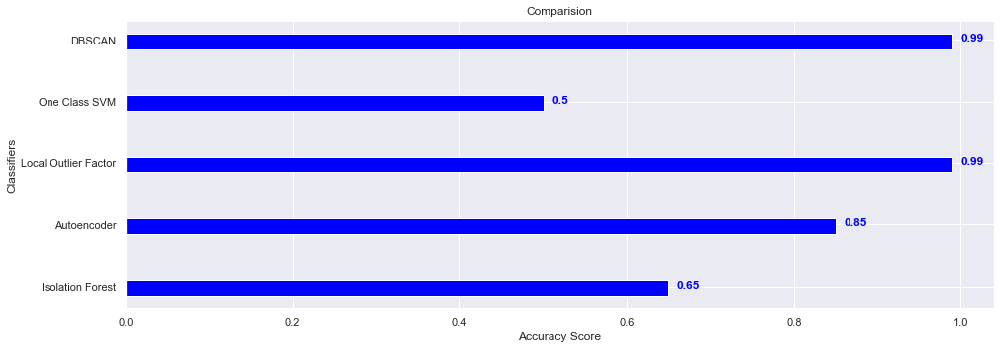



========================= NR_RTR_PORT_15 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     68.3 %     |
|     Autoencoder      |    81.05 %     |
| Local Outlier Factor |     99.4 %     |
|    One Class SVM     |    50.05 %     |
|        DBSCAN        |    99.11 %     |
+----------------------+----------------+


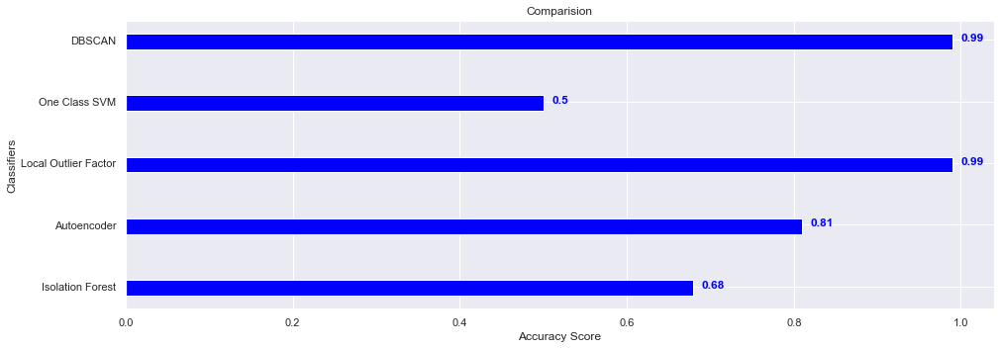



========================= NR_RTR_PORT_16 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    73.86 %     |
|     Autoencoder      |    80.11 %     |
| Local Outlier Factor |    99.45 %     |
|    One Class SVM     |    49.95 %     |
|        DBSCAN        |    99.16 %     |
+----------------------+----------------+


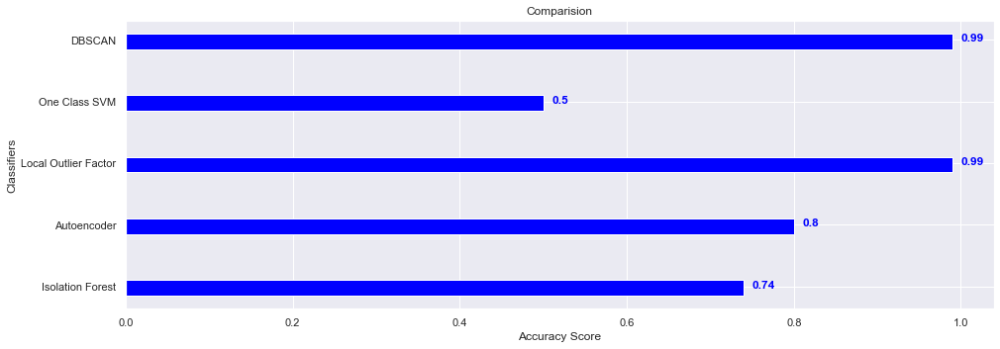



========================= NR_RTR_PORT_17 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    67.31 %     |
|     Autoencoder      |    82.29 %     |
| Local Outlier Factor |     99.4 %     |
|    One Class SVM     |    49.95 %     |
|        DBSCAN        |    99.36 %     |
+----------------------+----------------+


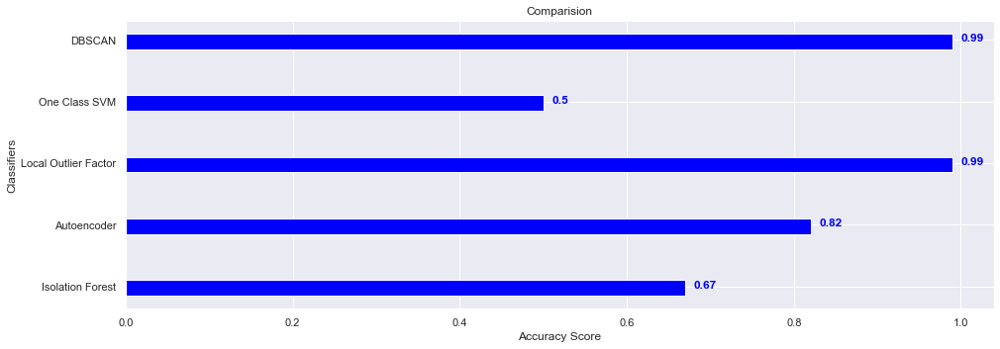



========================= NR_RTR_PORT_18 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    65.62 %     |
|     Autoencoder      |    82.94 %     |
| Local Outlier Factor |    99.31 %     |
|    One Class SVM     |    50.15 %     |
|        DBSCAN        |    98.91 %     |
+----------------------+----------------+


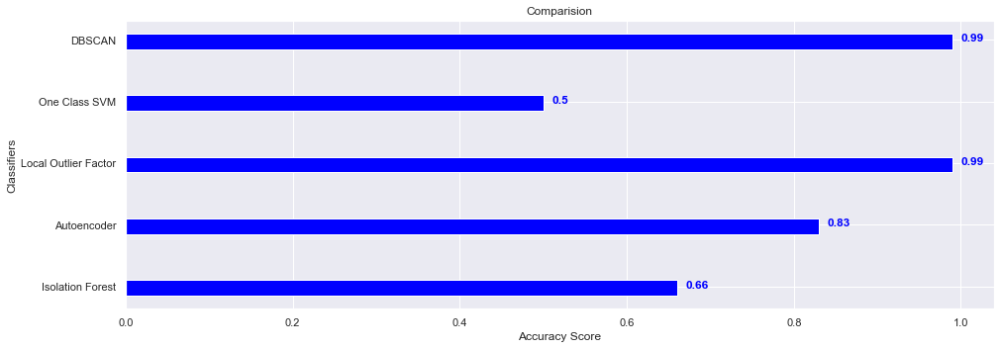



========================= NR_RTR_PORT_19 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    74.45 %     |
|     Autoencoder      |    82.34 %     |
| Local Outlier Factor |    99.31 %     |
|    One Class SVM     |    50.15 %     |
|        DBSCAN        |     99.5 %     |
+----------------------+----------------+


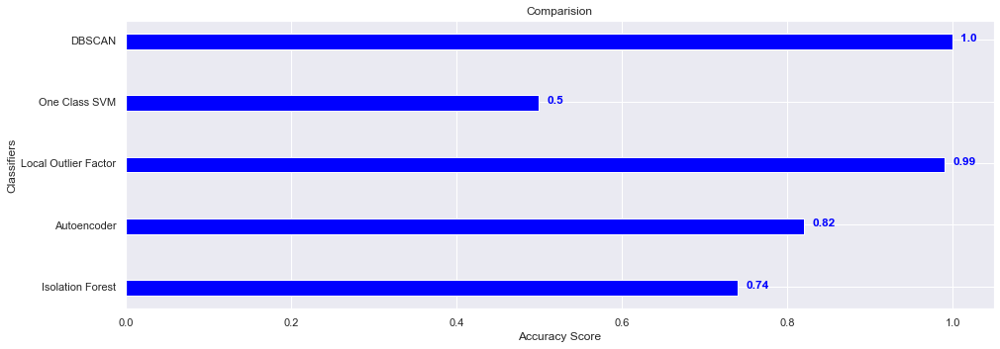



========================= NR_RTR_PORT_20 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    66.37 %     |
|     Autoencoder      |    84.18 %     |
| Local Outlier Factor |    99.55 %     |
|    One Class SVM     |    50.15 %     |
|        DBSCAN        |    99.06 %     |
+----------------------+----------------+


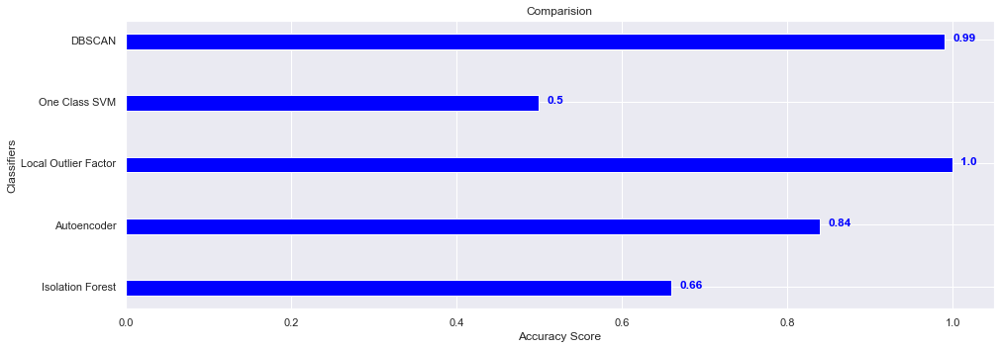

In [35]:
for i in range(20):
    
    print("\n\n ========================================================")
    print("========================= NR_RTR_PORT_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    print("\nPerformance with Models")
    print("=======================\n")
    x=PrettyTable()
    x.add_column("Classifier Name",["Isolation Forest","Autoencoder","Local Outlier Factor", "One Class SVM", "DBSCAN"])
    x.add_column("Accuracy Score",[str(round(accuracy_1[i]*100,2)) + " %", str(round(accuracy_2[i]*100,2)) + " %", str(round(accuracy_3[i]*100,2)) + " %", str(round(accuracy_4[i]*100,2)) + " %", str(round(accuracy_5[i]*100,2)) + " %"])
    print(x)

    x = ["Isolation Forest","Autoencoder","Local Outlier Factor", "One Class SVM", "DBSCAN"]
    y = [round(accuracy_1[i],2), round(accuracy_2[i],2), round(accuracy_3[i],2), round(accuracy_4[i],2), round(accuracy_5[i],2)]

    plt.rcParams["figure.figsize"] = (14,5)
    fig, ax = plt.subplots() 
    width = 0.25
    ind = np.arange(len(y))
    ax.barh(ind, y, width, color="blue")
    ax.set_yticks((ind+width/2)-0.1)
    ax.set_yticklabels(x, minor=False)
    for i, v in enumerate(y):
        ax.text(v + 0.01, i , str(v), color='blue', fontweight='bold')
    plt.title('Comparision')
    plt.xlabel('Accuracy Score')
    plt.ylabel('Classifiers')      
    plt.show()